# Rainfall Prediction - Weather Forecasting

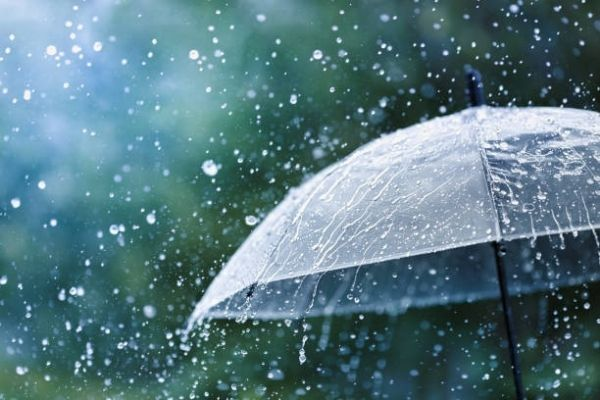

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:

# 1. Problem Statement:

a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.

# Dataset Description:

Number of columns: <b>23</b>


Date  - The date of observation

Location  -The common name of the location of the weather station

MinTemp  -The minimum temperature in degrees celsius

MaxTemp -The maximum temperature in degrees celsius

Rainfall  -The amount of rainfall recorded for the day in mm

Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am

Sunshine  -The number of hours of bright sunshine in the day.

WindGustDi r- The direction of the strongest wind gust in the 24 hours to midnight

WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight

WindDir9am -Direction of the wind at 9am

WindDir3pm -Direction of the wind at 3pm

WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am

WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm

Humidity9am -Humidity (percent) at 9am

Humidity3pm -Humidity (percent) at 3pm

Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am

Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm

Cloud9am - Fraction of sky obscured by cloud at 9am. 

Cloud3pm -Fraction of sky obscured by cloud 

Temp9am-Temperature (degrees C) at 9am

Temp3pm -Temperature (degrees C) at 3pm

RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0

RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('weatherAUS.csv')
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [3]:
type(df)

pandas.core.frame.DataFrame

In [4]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [5]:
df.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
8424,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [6]:
df.sample(3)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
6293,2011-07-13,Brisbane,5.6,23.5,0.0,2.4,9.6,W,20.0,SW,...,63.0,21.0,1022.2,1018.5,7.0,3.0,11.7,23.0,No,No
6353,2011-09-11,Brisbane,7.0,22.9,0.0,9.2,11.2,WSW,31.0,W,...,42.0,27.0,1017.2,1012.8,0.0,1.0,15.8,22.6,No,No
5374,2009-11-17,Melbourne,14.9,22.6,0.0,7.6,8.7,S,39.0,SSE,...,52.0,53.0,1011.4,1010.1,7.0,1.0,18.4,20.8,No,No


In [7]:
df.shape

(8425, 23)

<b>The dataset consists of 8425 rows and 23 columns.</b>

In [8]:
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

<b>The dataset consists of 23 columns. Here, the columns 'RainTomorrow' and 'Rainfall' are the target variables and the remaining columns are the features.</b>

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

In [10]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [11]:
# As the column 'Date' is of object datatype, let us convert it into datetime type

df['Date'] = pd.to_datetime(df['Date'])

In [12]:
df.dtypes

Date             datetime64[ns]
Location                 object
MinTemp                 float64
MaxTemp                 float64
Rainfall                float64
Evaporation             float64
Sunshine                float64
WindGustDir              object
WindGustSpeed           float64
WindDir9am               object
WindDir3pm               object
WindSpeed9am            float64
WindSpeed3pm            float64
Humidity9am             float64
Humidity3pm             float64
Pressure9am             float64
Pressure3pm             float64
Cloud9am                float64
Cloud3pm                float64
Temp9am                 float64
Temp3pm                 float64
RainToday                object
RainTomorrow             object
dtype: object

In [13]:
#Extracting Day from Date column
df['Day'] = pd.to_datetime(df.Date,format="%d/%m/%Y").dt.day


#Extracting Month from Date column
df['Month'] = pd.to_datetime(df.Date, format="%d/%m/%Y").dt.month


#Extracting Year from Date column
df['Year'] = pd.to_datetime(df.Date, format="%d/%m/%Y").dt.year

In [14]:
# Now, let's drop the column 'Date'

df.drop(columns = ['Date'],inplace = True)
df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,1007.1,8.0,NaN,16.9,21.8,No,No,1,12,2008
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,1007.8,NaN,NaN,17.2,24.3,No,No,2,12,2008
2,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,1008.7,NaN,2.0,21.0,23.2,No,No,3,12,2008
3,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,...,1012.8,NaN,NaN,18.1,26.5,No,No,4,12,2008
4,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,1006.0,7.0,8.0,17.8,29.7,No,No,5,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,...,1020.3,NaN,NaN,10.1,22.4,No,No,21,6,2017
8421,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,...,1019.1,NaN,NaN,10.9,24.5,No,No,22,6,2017
8422,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,...,1016.8,NaN,NaN,12.5,26.1,No,No,23,6,2017
8423,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,N,...,1016.5,3.0,2.0,15.1,26.0,No,No,24,6,2017


In [15]:
# Let's check the number of unique values present in the dataset

df.nunique()

Location          12
MinTemp          285
MaxTemp          331
Rainfall         250
Evaporation      116
Sunshine         140
WindGustDir       16
WindGustSpeed     52
WindDir9am        16
WindDir3pm        16
WindSpeed9am      34
WindSpeed3pm      35
Humidity9am       90
Humidity3pm       94
Pressure9am      384
Pressure3pm      374
Cloud9am           9
Cloud3pm           9
Temp9am          304
Temp3pm          328
RainToday          2
RainTomorrow       2
Day               31
Month             12
Year              10
dtype: int64

<b>As we can see, the target column 'RainTomorrow' has 2 classes. Hence, it is a classification problem.          
The other target column 'Rainfall' consists of continuous data. Hence, it is a regression problem.</b>

In [16]:
# Let's check the null values

df.isnull().sum()

Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
Day                 0
Month               0
Year                0
dtype: int64

<AxesSubplot:>

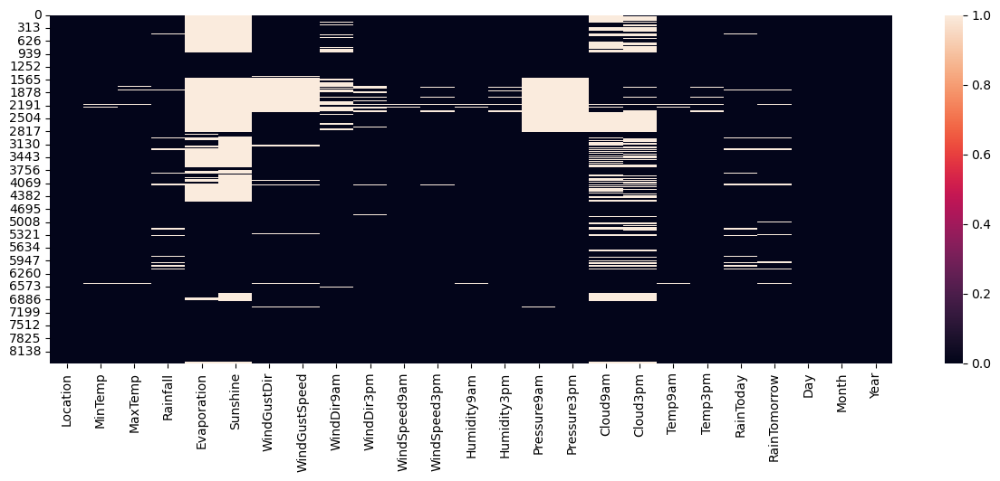

In [17]:
plt.figure(figsize=(15,5))

sns.heatmap(df.isnull())

<b>As we can see, null values are present in all the columns, except the  columns 'Date' and 'Location'</b>

In [18]:
#Filling null values in MinTemp with it's mean
df['MinTemp'] = df['MinTemp'].fillna(df['MinTemp'].mean())

#Filling null values in MaxTemp with it's mean
df['MaxTemp'] = df['MaxTemp'].fillna(df['MaxTemp'].mean())

#Fillinf null values in Rainfall with it's mode, as most of the rows have 0 rainfall.
df['Rainfall'] = df['Rainfall'].fillna(df['Rainfall'].mode()[0])

#Filling null values in Evaporation with it's mean
df['Evaporation'] = df['Evaporation'].fillna(df['Evaporation'].mean())

#Filling null values in Sunshine with it's mean
df['Sunshine'] = df['Sunshine'].fillna(df['Sunshine'].mean())

#Filling null values in WindGustDir with it's mode
df['WindGustDir'] = df['WindGustDir'].fillna(df['WindGustDir'].mode()[0])

#Filling null values in WindGustSpeed with it's mean
df['WindGustSpeed'] = df['WindGustSpeed'].fillna(df['WindGustSpeed'].mean())

#Filling null values in WindDir9am with it's mode
df['WindDir9am'] = df['WindDir9am'].fillna(df['WindDir9am'].mode()[0])

#Filling null values in WindDir3pm with it's mode
df['WindDir3pm'] = df['WindDir3pm'].fillna(df['WindDir3pm'].mode()[0])

#Filling null values in WindSpeed9am with it's mean
df['WindSpeed9am'] = df['WindSpeed9am'].fillna(df['WindSpeed9am'].mean())

#Filling null values in WindSpeed3pm with it's mean
df['WindSpeed3pm'] = df['WindSpeed3pm'].fillna(df['WindSpeed3pm'].mean())

#Filling null values in Humidity9am with it's mean
df['Humidity9am'] = df['Humidity9am'].fillna(df['Humidity9am'].mean())

#Filling null values in Humidity3pm with it's mean
df['Humidity3pm'] = df['Humidity3pm'].fillna(df['Humidity3pm'].mean())

#Filling null values in Pressure9am with it's mean
df['Pressure9am'] = df['Pressure9am'].fillna(df['Pressure9am'].mean())

#Filling null values in Pressure3pm with it's mean
df['Pressure3pm'] = df['Pressure3pm'].fillna(df['Pressure3pm'].mean())

#Filling null values in Cloud9am with it's mean
df['Cloud9am'] = df['Cloud9am'].fillna(df['Cloud9am'].mean())

#Filling null values in Cloud3pm with it's mean
df['Cloud3pm'] = df['Cloud3pm'].fillna(df['Cloud3pm'].mean())

#Filling null values in Temp9am with it's mean
df['Temp9am'] = df['Temp9am'].fillna(df['Temp9am'].mean())

#Filling null values in Temp3pm with it's mean
df['Temp3pm'] = df['Temp3pm'].fillna(df['Temp3pm'].mean())

#Filling null values in Temp3pm with it's mean
df['Temp3pm'] = df['Temp3pm'].fillna(df['Temp3pm'].mean())

#Filling null values in RainToday with it's mode
df['RainToday'] = df['RainToday'].fillna(df['RainToday'].mode()[0])

#Filling null values in RainTomorrow with it's mode
df['RainTomorrow'] = df['RainTomorrow'].fillna(df['RainTomorrow'].mode()[0])

In [19]:
# Let's check the null values again

df.isnull().sum()

Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
Day              0
Month            0
Year             0
dtype: int64

<AxesSubplot:>

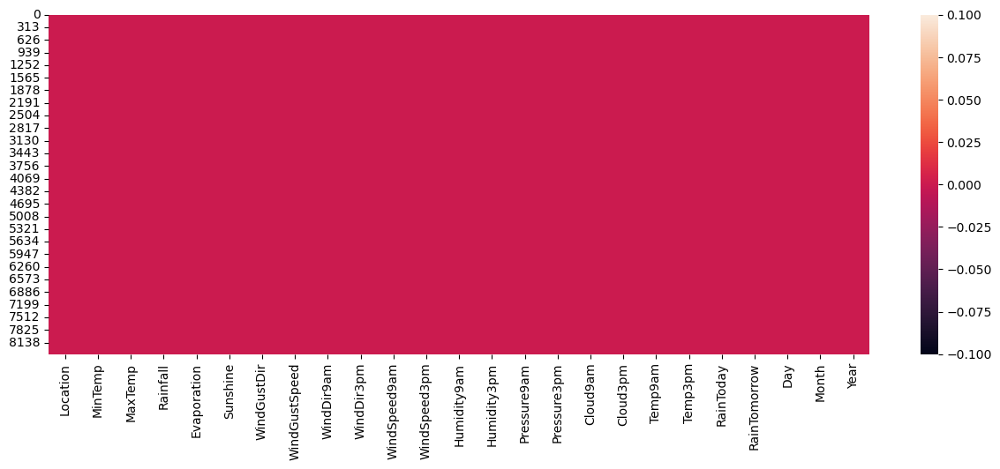

In [20]:
plt.figure(figsize=(15,5))

sns.heatmap(df.isnull())

<b>We can confirm that there are no null values in the dataset by looking at the Heat Map.</b>

In [21]:
# Let's check the value counts of each column

for i in df.columns:
    print('\n','__________________________________')
    print(df[i].value_counts())


 __________________________________
Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64

 __________________________________
 13.193305    75
 12.000000    74
 13.200000    71
 13.800000    69
 12.700000    68
              ..
-1.100000      1
 1.400000      1
-1.400000      1
-1.700000      1
 26.000000     1
Name: MinTemp, Length: 286, dtype: int64

 __________________________________
19.0    87
23.8    75
19.8    74
25.0    71
22.3    68
        ..
8.2      1
10.3     1
39.7     1
9.4      1
43.5     1
Name: MaxTemp, Length: 332, dtype: int64

 __________________________________
0.0      5539
0.2       406
0.4       177
0.6       116
1.2        86
         ... 
61.2        1
128.0       1
90.0        1
34.4        1
40.0        1
Name: Rainfall, Length: 250

In [22]:
df.dtypes

Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
Day                int64
Month              int64
Year               int64
dtype: object

<b>As we can see, some columns are of object datatype. So, we need to carry out encoding techniques.</b>

# Statistical Description of the Dataset

In [23]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Day,Month,Year
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.193305,23.859976,2.725982,5.389395,7.632205,40.174469,13.847646,18.533662,67.822496,51.249790,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.442934,15.741958,6.442136,2012.102433
std,5.379488,6.114516,10.319872,3.852004,2.825451,13.776101,10.128579,9.704759,16.774231,18.311894,6.275759,6.217451,2.429205,2.299419,5.608301,5.945849,8.787354,3.437994,2.473137
min,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,0.000000,0.000000,1.900000,7.300000,1.000000,1.000000,2008.000000
25%,9.300000,19.300000,0.000000,4.000000,7.632205,31.000000,6.000000,11.000000,56.000000,39.000000,1014.000000,1011.400000,3.000000,3.000000,13.800000,18.100000,8.000000,3.000000,2010.000000
50%,13.200000,23.300000,0.000000,5.389395,7.632205,40.174469,13.000000,19.000000,68.000000,51.000000,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.000000,16.000000,6.000000,2011.000000
75%,17.300000,28.000000,0.800000,5.389395,8.900000,48.000000,20.000000,24.000000,80.000000,63.000000,1021.300000,1018.800000,7.000000,7.000000,21.900000,26.300000,23.000000,9.000000,2014.000000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,8.000000,8.000000,39.400000,44.100000,31.000000,12.000000,2017.000000


<b>This provides the statistical description of the data set. As there are no negative / invalid values present in the dataset, we can say that the dataset appears perfect.</b>

In [24]:
# Now, let's separate the categorical columns

categorical_columns = []

for i in df.dtypes.index:
    if df.dtypes[i]=='object':
        categorical_columns.append(i)
print(categorical_columns)

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


In [25]:
# Now, let's separate the numerical columns

numerical_columns = []

for i in df.dtypes.index:
    if df.dtypes[i]!='object':
        numerical_columns.append(i)
print(numerical_columns)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Day', 'Month', 'Year']


# Data Visualization

# Univariate Analysis

<b>Now, let's visualize the categorical columns</b>

Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64


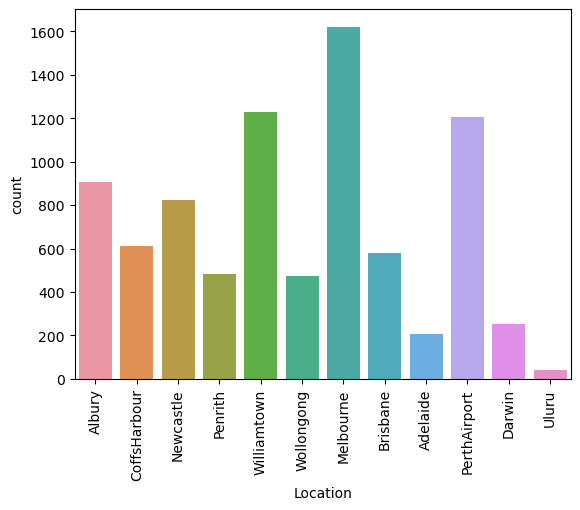

In [26]:
print(df['Location'].value_counts())
sns.countplot(df['Location'])
plt.xticks(rotation=90)
plt.show()

<b>As we can see, highest rainfall was recorded in Melbourne, followed by Williantown and PerthAirport.     
Lowest rainfall was recorded in Uluru.</b>

N      1704
SSE     578
S       577
SW      572
E       557
WNW     531
W       507
WSW     504
SE      484
ENE     415
SSW     396
NW      383
NE      353
NNE     343
ESE     302
NNW     219
Name: WindGustDir, dtype: int64


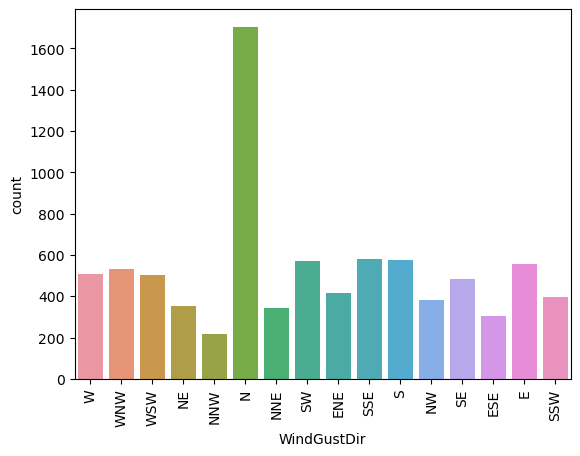

In [27]:
print(df['WindGustDir'].value_counts())
sns.countplot(df['WindGustDir'])
plt.xticks(rotation=90)
plt.show()

<b>As we can see, wind gust was strongest towards the North direction, followed by SSE and S.       
The wind gust was weakest towards the NNW direction.</b>

N      1735
SW      704
NW      625
WSW     543
SE      505
WNW     480
SSW     467
ENE     433
NNE     430
W       414
NE      409
S       402
E       380
SSE     365
NNW     280
ESE     253
Name: WindDir9am, dtype: int64


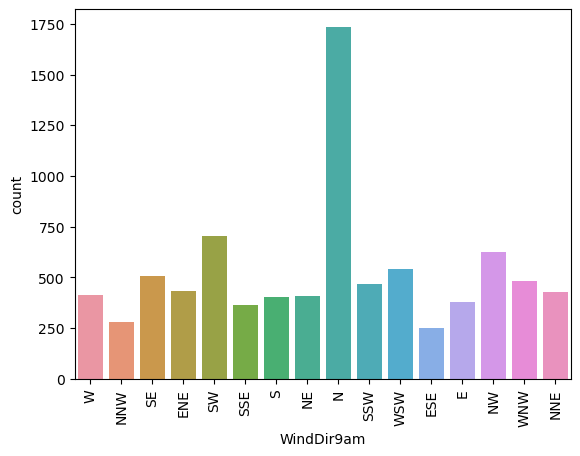

In [28]:
print(df['WindDir9am'].value_counts())
sns.countplot(df['WindDir9am'])
plt.xticks(rotation=90)
plt.show()

<b>As we can see, direction of the wind at 9am was strongest towards the North direction, followed by South-Western and North-Western direction.
Direction of the wind at 9am was weakest towards the ESE direction. 

SE     1121
S       742
SSE     623
WSW     580
NE      544
N       524
SW      494
WNW     487
NW      468
W       462
ESE     462
E       460
ENE     417
SSW     370
NNE     365
NNW     306
Name: WindDir3pm, dtype: int64


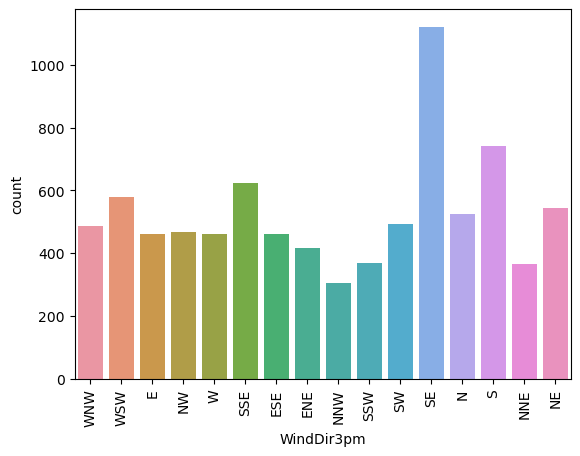

In [29]:
print(df['WindDir3pm'].value_counts())
sns.countplot(df['WindDir3pm'])
plt.xticks(rotation=90)
plt.show()

<b>As we can see, direction of the wind at 3pm was strongest towards the Soth-Eastern direction, followed by Southern and SSE direction.             
Direction of the wind at 3pm was weakest towards the NNW direction.</b>

No     6435
Yes    1990
Name: RainToday, dtype: int64


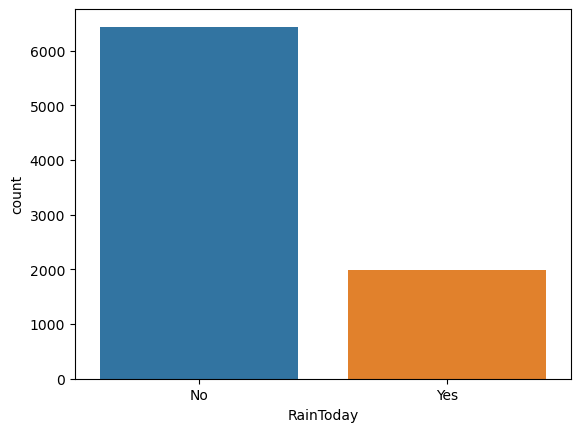

In [30]:
print(df['RainToday'].value_counts())
sns.countplot(df['RainToday'])
plt.show()

<b>As we can see, there are high chances that it will not rain today.</b>

No     6434
Yes    1991
Name: RainTomorrow, dtype: int64


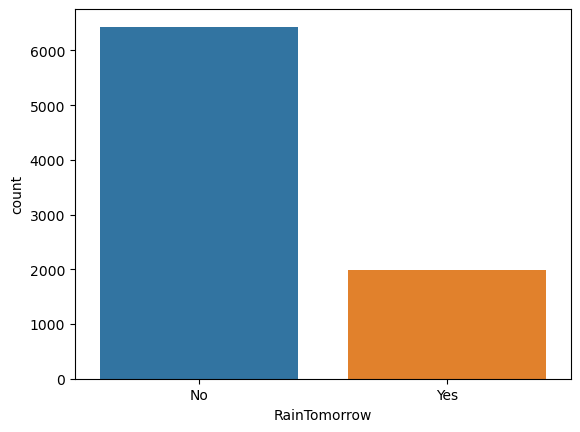

In [31]:
print(df['RainTomorrow'].value_counts())
sns.countplot(df['RainTomorrow'])
plt.show()

<b>As we can see, there are high chances that it will not rain tomorrow.</b>

# Checking the distribution of data for numerical columns

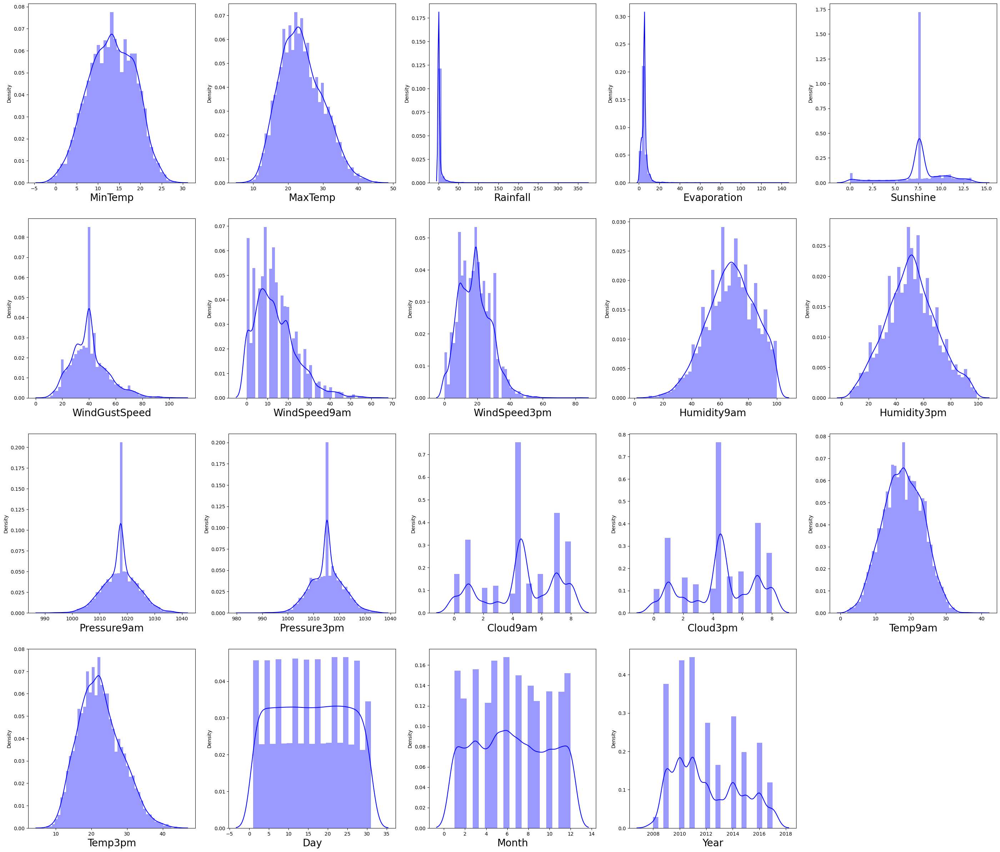

In [32]:
plt.figure(figsize=(35,30))
plotnumber = 1

for column in numerical_columns:
    if plotnumber<=20:
        ax = plt.subplot(4,5,plotnumber)
        sns.distplot(df[column], color='blue')
        plt.xlabel(column, fontsize=20)
    plotnumber+=1
plt.show()

<b>As we can see, none of the columns are normally distributed.</b>

# Bivariate Analysis

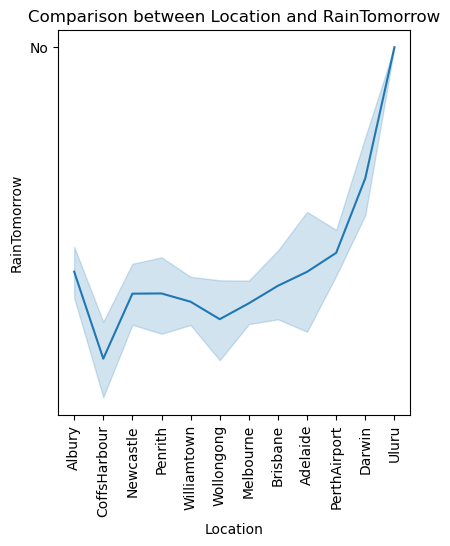

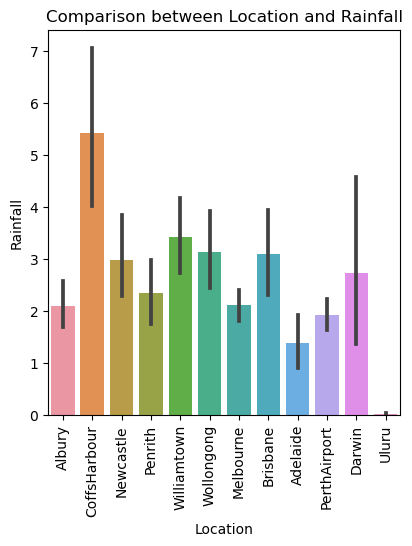

In [33]:
# Let's check the correlation of the column 'Location' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(10,5))
plt.subplot(1,2,2)
plt.title('Comparison between Location and RainTomorrow')
sns.lineplot(x='Location', y='RainTomorrow', data=df)
plt.xticks(rotation=90)
plt.show()


plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Location and Rainfall')
sns.barplot(x='Location', y='Rainfall', data=df)
plt.xticks(rotation=90)
plt.show()

<b>As we can see, it is likely to rain heavily tomorrow in the region 'CoffsHarbour', and it is likely to rain the least tomorrow in the region 'Uluru'.</b>

<b>As we can see, rainfall is recorded highest in the region 'CoffsHarbour', followed by 'Williamtown' and 'Brisbane'. The lowest rainfall is recorded in the region 'Uluru'.</b>

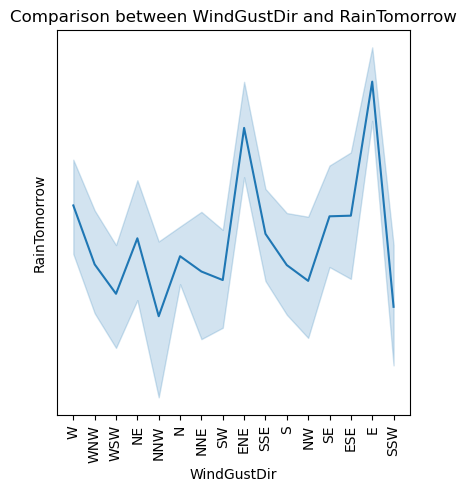

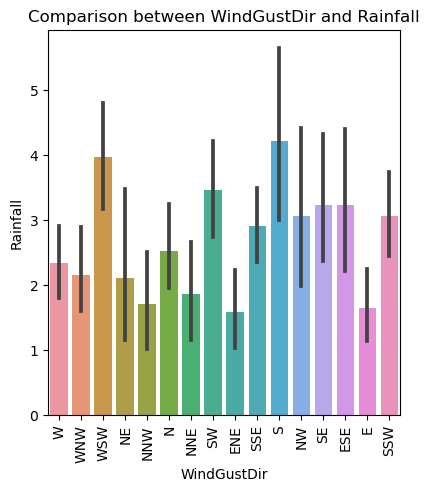

In [34]:
# Let's check the correlation of the column 'WindGustDir' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(10,5))
plt.subplot(1,2,2)
plt.title('Comparison between WindGustDir and RainTomorrow')
sns.lineplot(x='WindGustDir', y='RainTomorrow', data=df)
plt.xticks(rotation=90)
plt.show()


plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between WindGustDir and Rainfall')
sns.barplot(x='WindGustDir', y='Rainfall', data=df)
plt.xticks(rotation=90)
plt.show()

<b>As we can see, when the direction of the wind is strongest in the NNW direction, it is likely to rain tomorrow. When the direction of the wind is strongest in the eastern direction, it is likely that it will not rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the direction of the wind is strongest in the southern direction, followed by WSW and SW direction.</b>

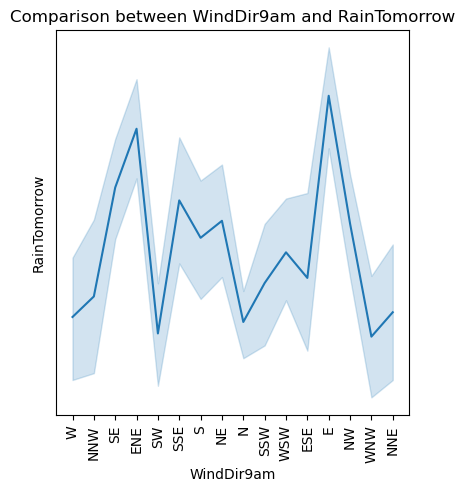

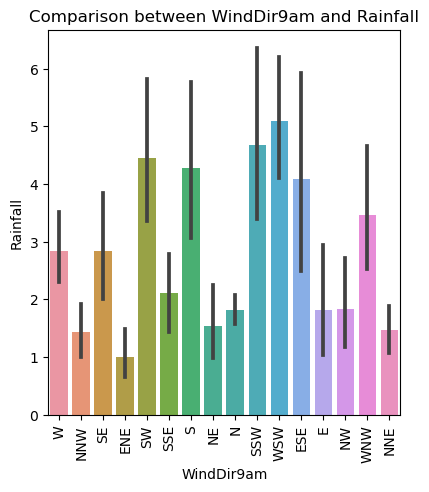

In [35]:
# Let's check the correlation of the column 'WindDir9am' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(10,5))
plt.subplot(1,2,2)
plt.title('Comparison between WindDir9am and RainTomorrow')
sns.lineplot(x='WindDir9am', y='RainTomorrow', data=df)
plt.xticks(rotation=90)
plt.show()


plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between WindDir9am and Rainfall')
sns.barplot(x='WindDir9am', y='Rainfall', data=df)
plt.xticks(rotation=90)
plt.show()

<b>As we can see, when the direction of the wind at 9am is in the WNW direction, it is likely to rain tomorrow. When the direction of the wind at 9am is in the eastern direction, it is likely that it will not rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the direction of the wind is strongest in the WSW direction, followed by SSW and SW direction.</b>

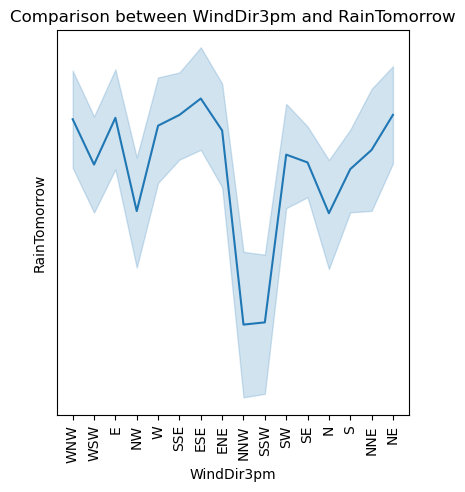

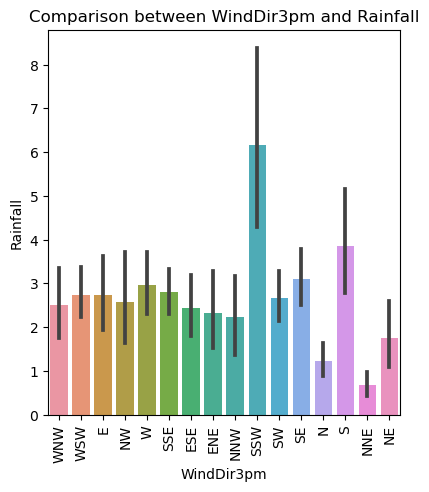

In [36]:
# Let's check the correlation of the column 'WindDir3pm' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(10,5))
plt.subplot(1,2,2)
plt.title('Comparison between WindDir3pm and RainTomorrow')
sns.lineplot(x='WindDir3pm', y='RainTomorrow', data=df)
plt.xticks(rotation=90)
plt.show()


plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between WindDir3pm and Rainfall')
sns.barplot(x='WindDir3pm', y='Rainfall', data=df)
plt.xticks(rotation=90)
plt.show()

<b>As we can see, when the direction of the wind at 3pm is in the NNW direction, it is likely to rain tomorrow. When the direction of the wind at 9am is in the ESE direction, it is likely that it will not rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the direction of the wind is strongest in the SSW direction, followed by S and SE direction.</b>

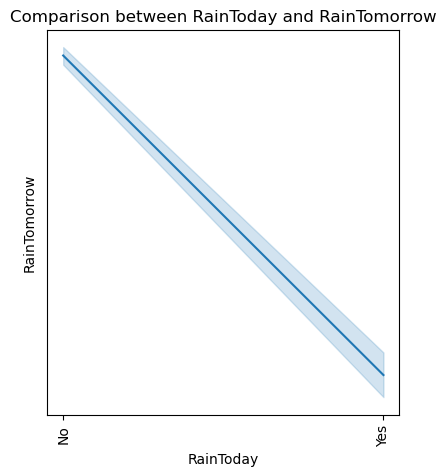

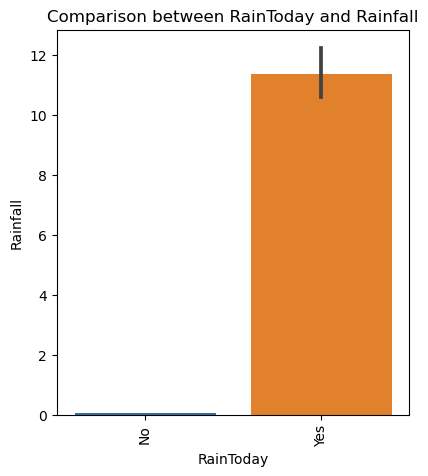

In [37]:
# Let's check the correlation of the column 'RainToday' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(10,5))
plt.subplot(1,2,2)
plt.title('Comparison between RainToday and RainTomorrow')
sns.lineplot(x='RainToday', y='RainTomorrow', data=df)
plt.xticks(rotation=90)
plt.show()

plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between RainToday and Rainfall')
sns.barplot(x='RainToday', y='Rainfall', data=df)
plt.xticks(rotation=90)
plt.show()

<b>As we can see, if it rains today, then it is most likely that it will tomaorrow as well. Similarly, if if does'nt rain today, then it is most likely that it will not rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, if it rains today.</b>

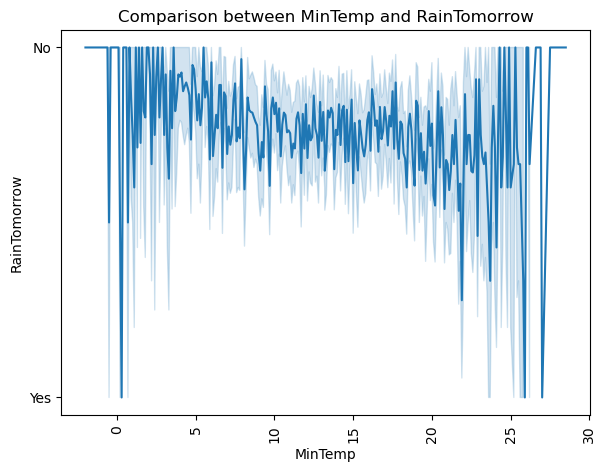

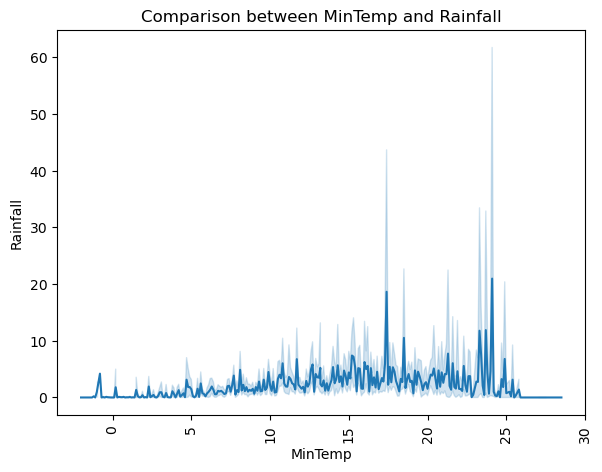

In [38]:
# Let's check the correlation of the column 'MinTemp' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between MinTemp and RainTomorrow')
sns.lineplot(x='MinTemp', y='RainTomorrow', data=df)
plt.xticks(rotation=90)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between MinTemp and Rainfall')
sns.lineplot(x='MinTemp', y='Rainfall', data=df)
plt.xticks(rotation=90)
plt.show()

<b>As we can see, MinTemp has no linear relationship with both the target variables 'RainTomorrow' and 'Rainfall'.</b>

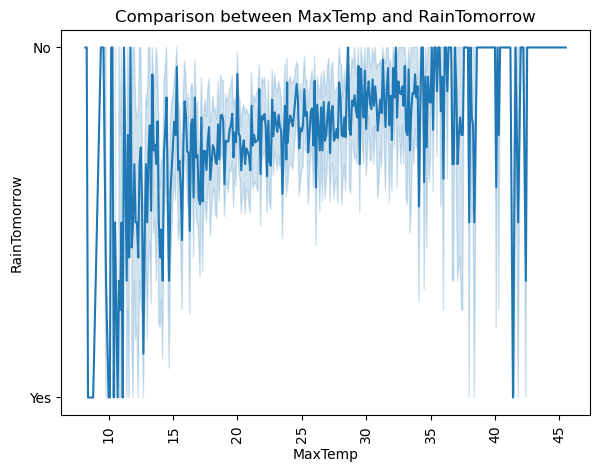

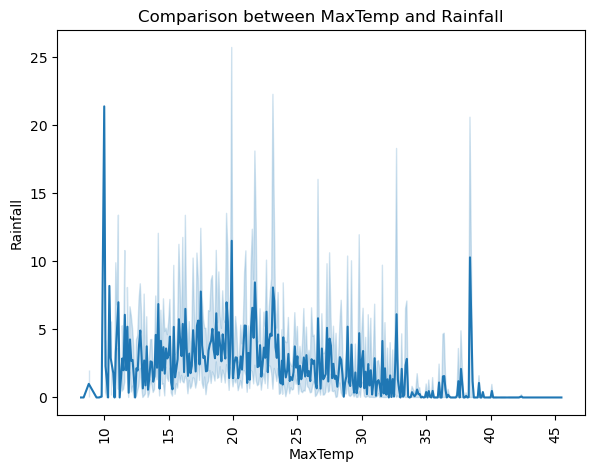

In [39]:
# Let's check the correlation of the column 'MaxTemp' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between MaxTemp and RainTomorrow')
sns.lineplot(x='MaxTemp', y='RainTomorrow', data=df)
plt.xticks(rotation=90)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between MaxTemp and Rainfall')
sns.lineplot(x='MaxTemp', y='Rainfall', data=df)
plt.xticks(rotation=90)
plt.show()

<b>As we can see, MaxTemp has no linear relationship with both the target variables 'RainTomorrow' and 'Rainfall'.</b>

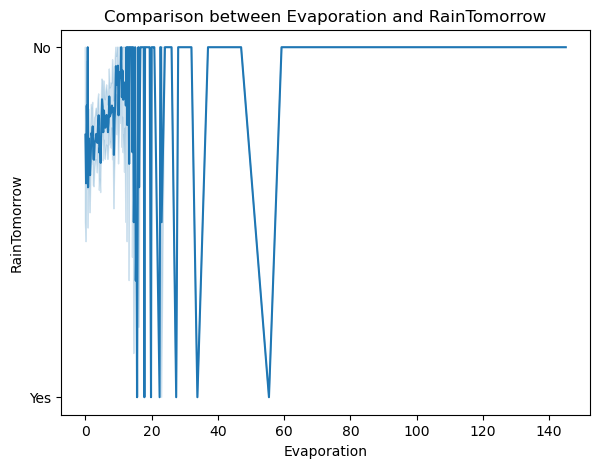

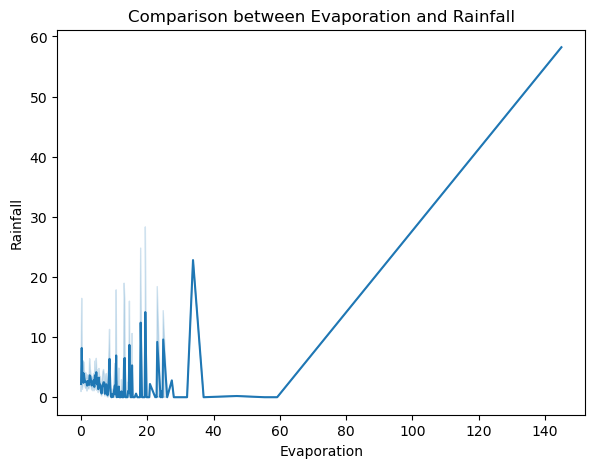

In [40]:
# Let's check the correlation of the column 'Evaporation' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Evaporation and RainTomorrow')
sns.lineplot(x='Evaporation', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Evaporation and Rainfall')
sns.lineplot(x='Evaporation', y='Rainfall', data=df)
plt.show()

<b>As we can see, when the rate of evaporation is greater than 60, then there is a possibility that it might not rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the rate of evaporation increases.</b>

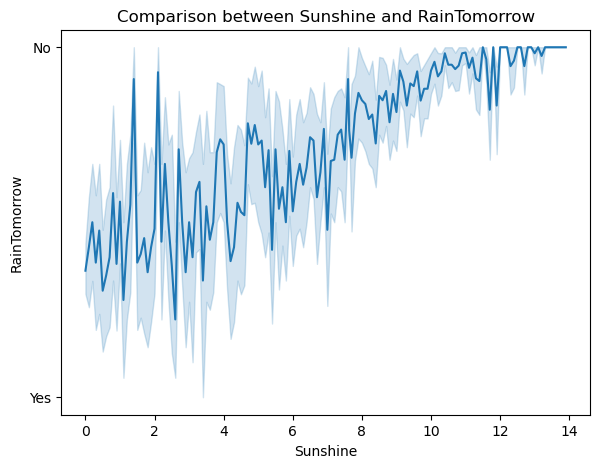

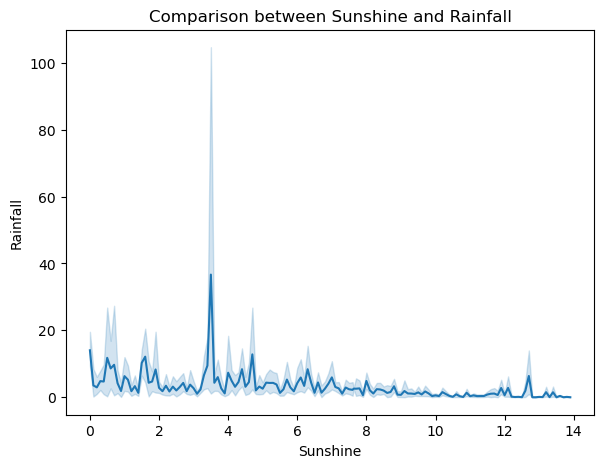

In [41]:
# Let's check the correlation of the column 'Sunshine' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Sunshine and RainTomorrow')
sns.lineplot(x='Sunshine', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Sunshine and Rainfall')
sns.lineplot(x='Sunshine', y='Rainfall', data=df)
plt.show()

<b>As we can see, as the sunshine increases, the possibility of rain tomorrow decreases.</b>

<b>Also, as the sunshine increases, the intensity of rainfall decreases.</b>

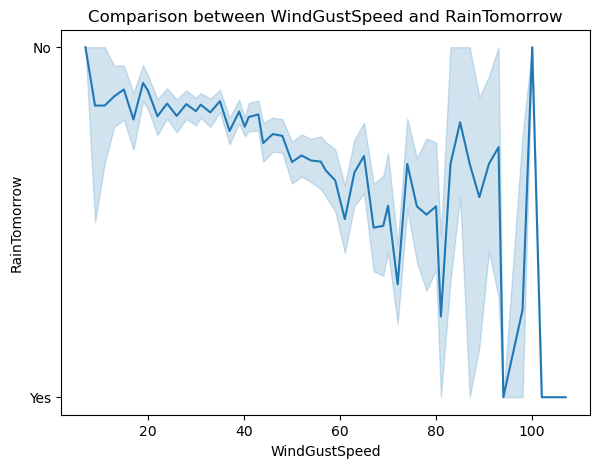

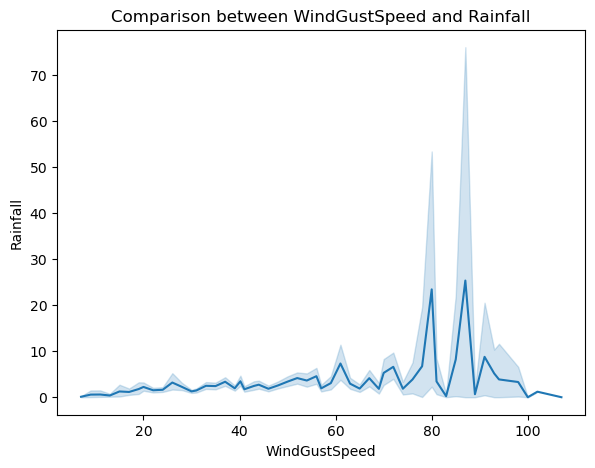

In [42]:
# Let's check the correlation of the column 'WindGustSpeed' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between WindGustSpeed and RainTomorrow')
sns.lineplot(x='WindGustSpeed', y='RainTomorrow', data=df)
plt.show()


plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between WindGustSpeed and Rainfall')
sns.lineplot(x='WindGustSpeed', y='Rainfall', data=df)
plt.show()

<b>As we can see, when the speed of the strongest wind gust speed increases, then there is a possibility that it might rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the speed of the strongest wind gust is between 75-90 km/hr.</b>

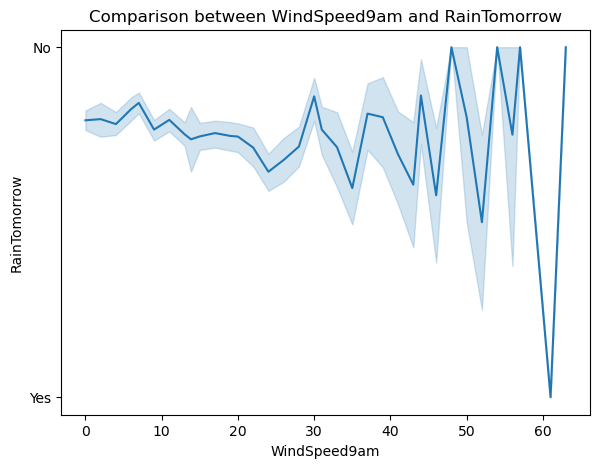

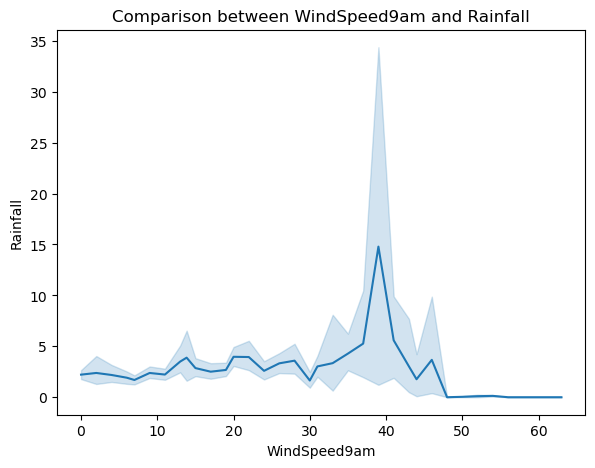

In [43]:
# Let's check the correlation of the column 'WindSpeed9am' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between WindSpeed9am and RainTomorrow')
sns.lineplot(x='WindSpeed9am', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between WindSpeed9am and Rainfall')
sns.lineplot(x='WindSpeed9am', y='Rainfall', data=df)
plt.show()

<b>As we can see, when the wind speed at 9am is greater than 65 km/hr, then there is a possibility that it might not rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the wind speed at 9am is between 35-45 km/hr.</b>

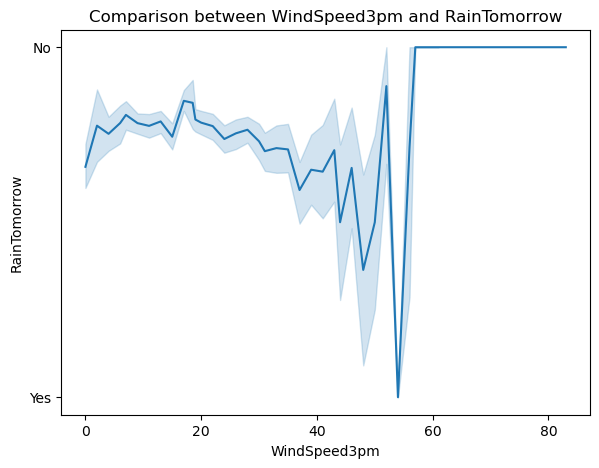

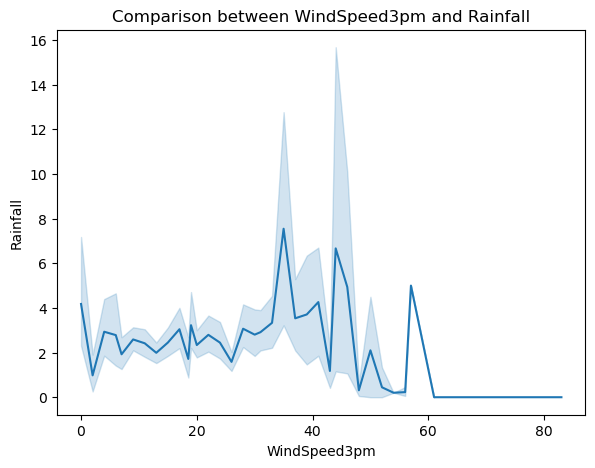

In [44]:
# Let's check the correlation of the column 'WindSpeed3pm' with both the targets ('Rainfall' and 'RainTomorrow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between WindSpeed3pm and RainTomorrow')
sns.lineplot(x='WindSpeed3pm', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between WindSpeed3pm and Rainfall')
sns.lineplot(x='WindSpeed3pm', y='Rainfall', data=df)
plt.show()

<b>As we can see, when the wind speed at 3pm is greater than 60 km/hr, then there is a possibility that it might not rain tomorrow.

<b>As we can see, rainfall is recorded highest, when the wind speed at 3pm is between 35-50 km/hr.

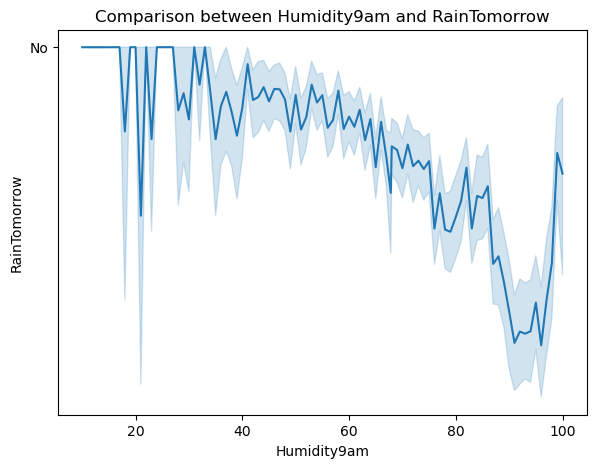

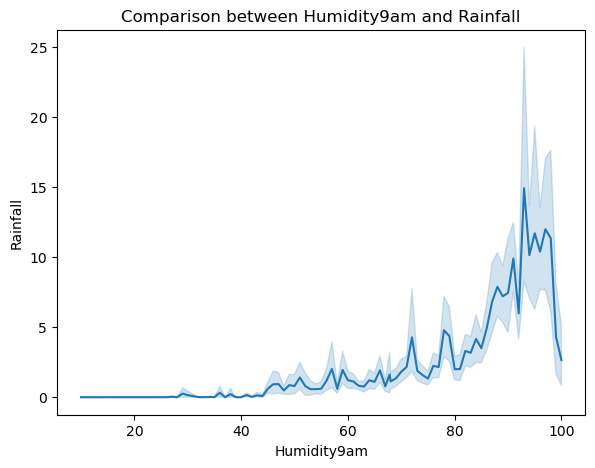

In [45]:
# Let's check the correlation of the column 'Humidity9am' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Humidity9am and RainTomorrow')
sns.lineplot(x='Humidity9am', y='RainTomorrow', data=df)
plt.show()


plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Humidity9am and Rainfall')
sns.lineplot(x='Humidity9am', y='Rainfall', data=df)
plt.show()

<b>As we can see, as the humidity at 9 am increases till 98 percent, there is a possibility that it might not rain tomorrow. If the humidity at 9 am is more than 98 percent, then there is a possibility that it might rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the humidity at 9 am is between 80-98 percent.</b>

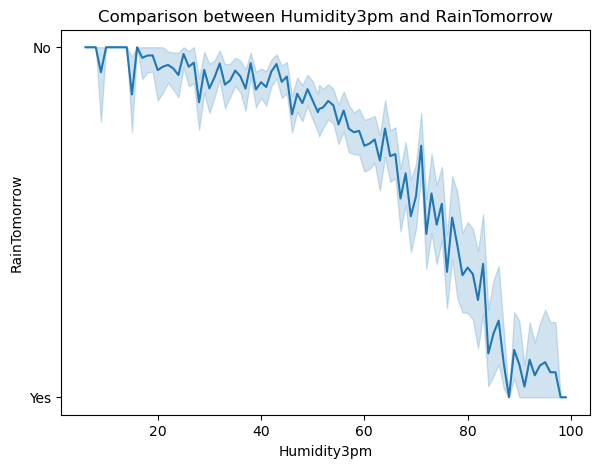

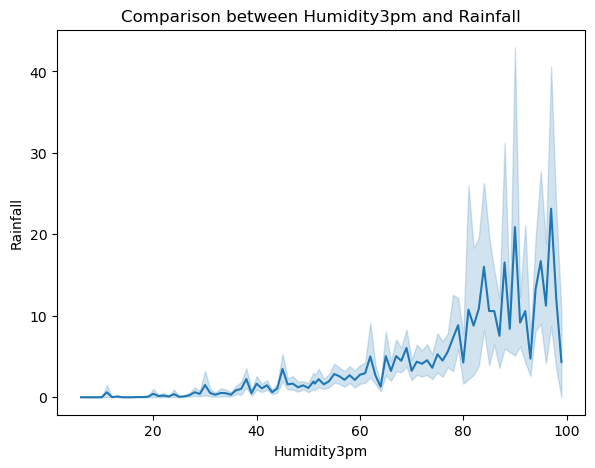

In [46]:
# Let's check the correlation of the column 'Humidity3pm' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Humidity3pm and RainTomorrow')
sns.lineplot(x='Humidity3pm', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Humidity3pm and Rainfall')
sns.lineplot(x='Humidity3pm', y='Rainfall', data=df)
plt.show()

<b>As we can see, as the humidity at 3 pm increases, there is a possibility that it might rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the humidity at 3pm is between 80-100 percent.</b>

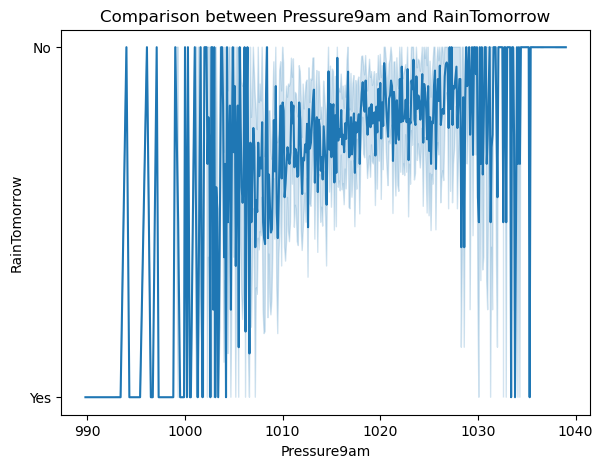

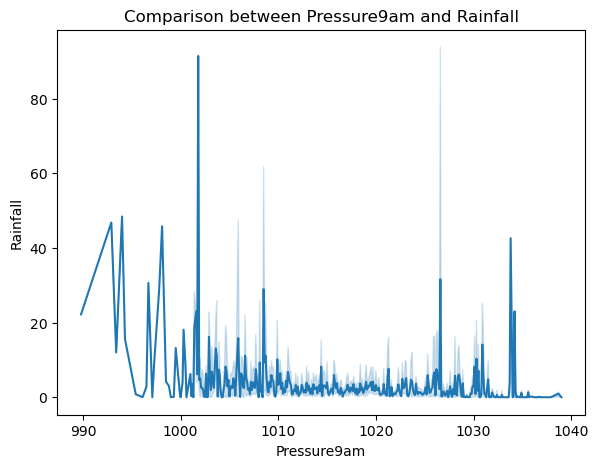

In [47]:
# Let's check the correlation of the column 'Pressure9am' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Pressure9am and RainTomorrow')
sns.lineplot(x='Pressure9am', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Pressure9am and Rainfall')
sns.lineplot(x='Pressure9am', y='Rainfall', data=df)
plt.show()

<b>As we can see, Pressure9am has no linear relationship with both the target variables 'RainTomorrow' and 'Rainfall'.</b>

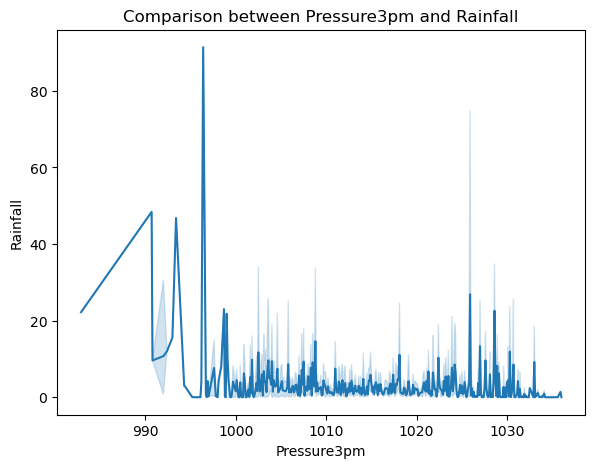

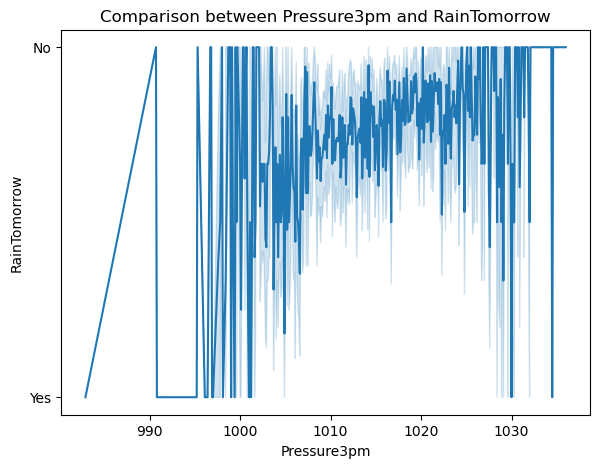

In [48]:
# Let's check the correlation of the column 'Pressure3pm' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Pressure3pm and Rainfall')
sns.lineplot(x='Pressure3pm', y='Rainfall', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Pressure3pm and RainTomorrow')
sns.lineplot(x='Pressure3pm', y='RainTomorrow', data=df)
plt.show()

<b>As we can see, Pressure3pm has no linear relationship with both the target variables 'RainTomorrow' and 'Rainfall'.</b>

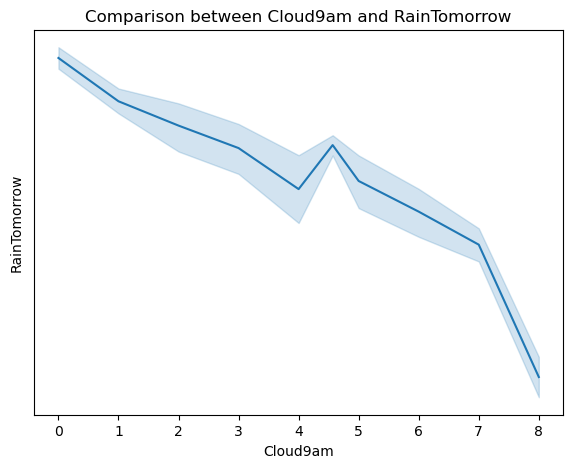

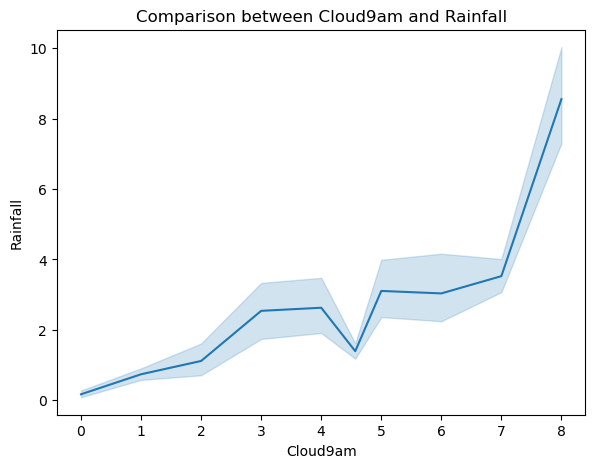

In [49]:
# Let's check the correlation of the column 'Cloud9am' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Cloud9am and RainTomorrow')
sns.lineplot(x='Cloud9am', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Cloud9am and Rainfall')
sns.lineplot(x='Cloud9am', y='Rainfall', data=df)
plt.show()

<b>As we can see, as the fraction of clouds covering the sky at 9 am increases, then there is a possibility that it might rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when 70-80% of the sky is covered by clouds at 9 am.</b>

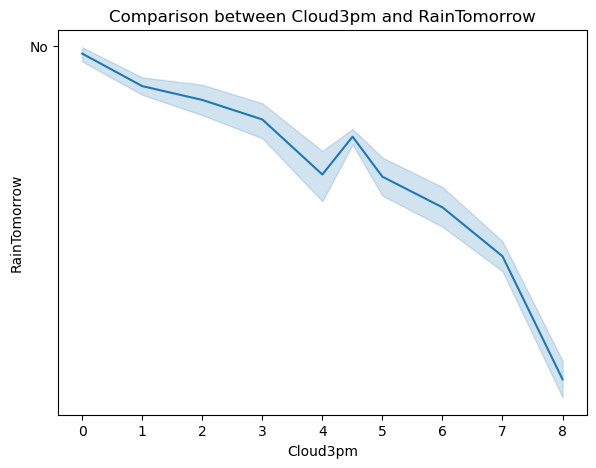

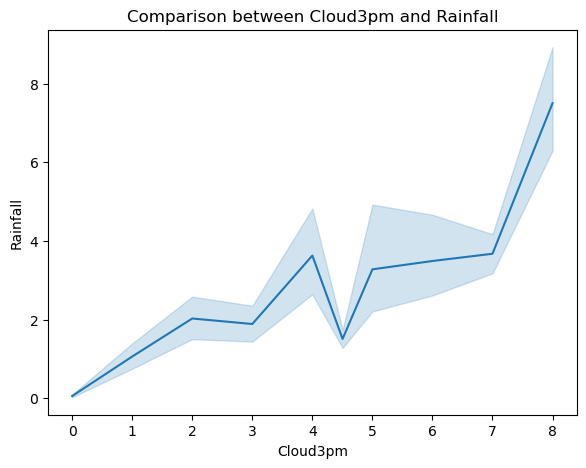

In [50]:
# Let's check the correlation of the column 'Cloud3pm' with both the targets ('Rainfall' and 'RainTommorow')
 

plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Cloud3pm and RainTomorrow')
sns.lineplot(x='Cloud3pm', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Cloud3pm and Rainfall')
sns.lineplot(x='Cloud3pm', y='Rainfall', data=df)
plt.show()

<b>As we can see, as the fraction of clouds covering the sky at 3 pm increases, then there is a possibility that it might rain tomorrow.</b>

<b>As we can see, rainfall is recorded highest, when 70-80% of the sky is covered by clouds at 3 pm.</b>

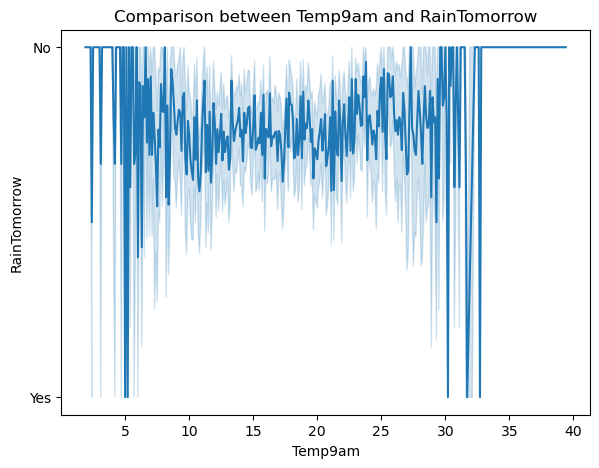

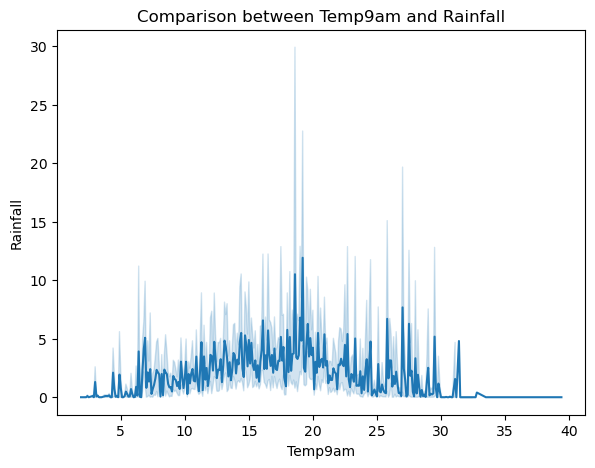

In [51]:
# Let's check the correlation of the column 'Temp9am' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Temp9am and RainTomorrow')
sns.lineplot(x='Temp9am', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Temp9am and Rainfall')
sns.lineplot(x='Temp9am', y='Rainfall', data=df)
plt.show()

<b>As we can see, Temp9am has no linear relationship with RainTomorrow.</b>

<b>As we can see, rainfall is recorded highest, when the temperature at 9 am is between 18-22 degrees C.</b>

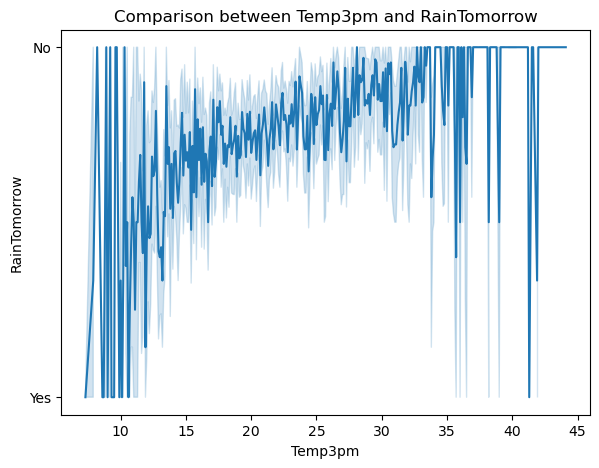

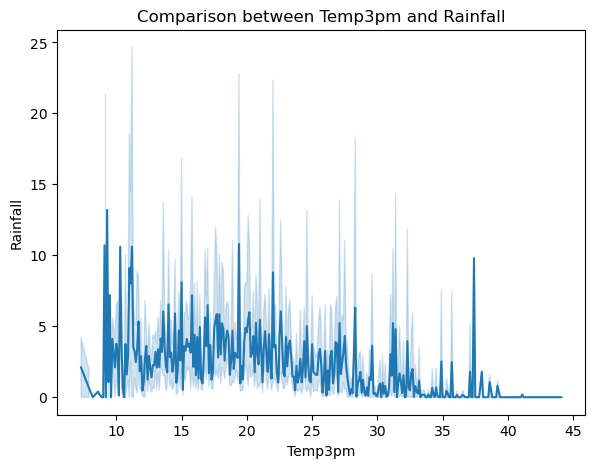

In [52]:
# Let's check the correlation of the column 'Temp3pm' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Temp3pm and RainTomorrow')
sns.lineplot(x='Temp3pm', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Temp3pm and Rainfall')
sns.lineplot(x='Temp3pm', y='Rainfall', data=df)
plt.show()

<b>As we can see, Temp3pm has no linear relationship with both the target variables 'RainTomorrow' and 'Rainfall'.</b>

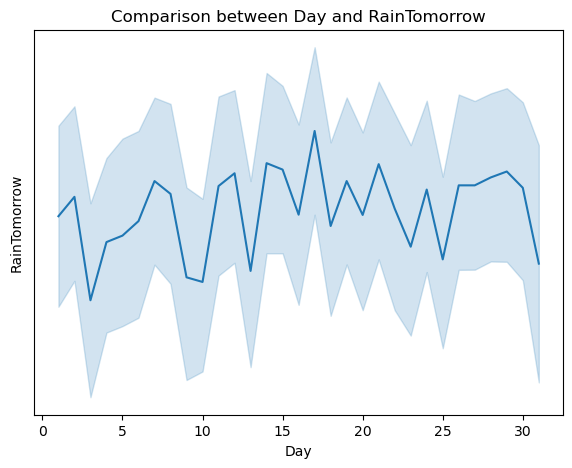

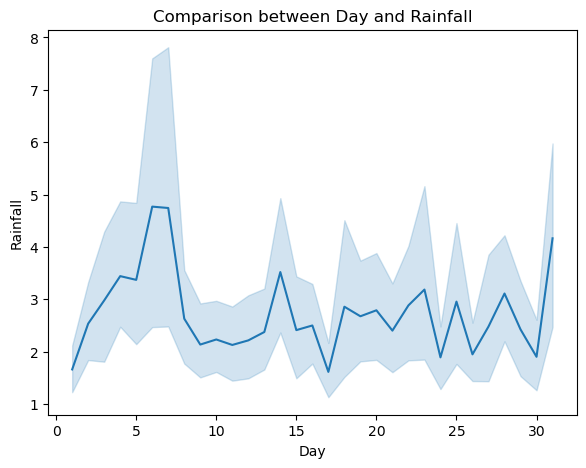

In [53]:
# Let's check the correlation of the column 'Day' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Day and RainTomorrow')
sns.lineplot(x='Day', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Day and Rainfall')
sns.lineplot(x='Day', y='Rainfall', data=df)
plt.show()

<b>As we can see, 'Day' has no linear relationship with both the target variables 'RainTomorrow' and 'Rainfall'.</b>

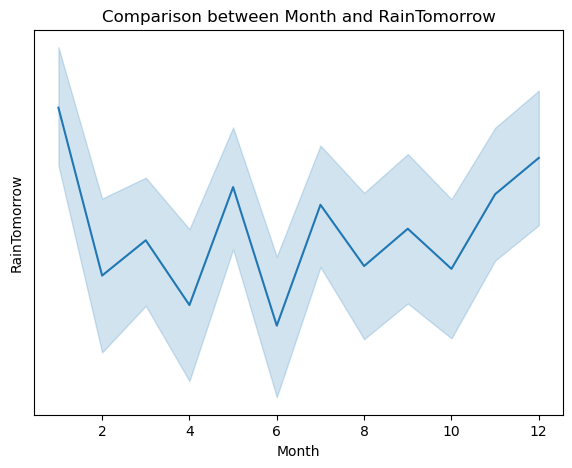

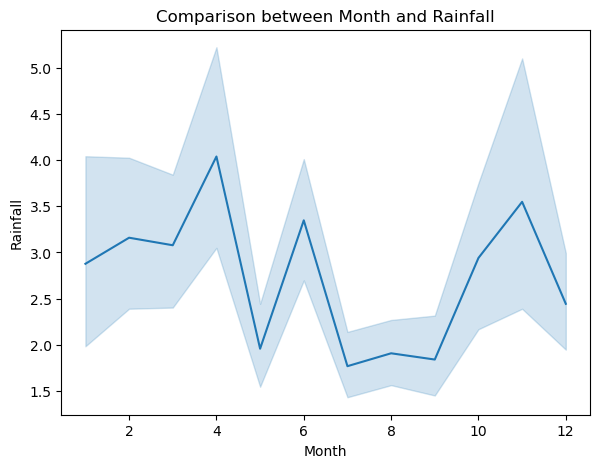

In [54]:
# Let's check the correlation of the column 'Month' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Month and RainTomorrow')
sns.lineplot(x='Month', y='RainTomorrow', data=df)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Month and Rainfall')
sns.lineplot(x='Month', y='Rainfall', data=df)
plt.show()

<b>As we can see, 'Month' has no linear relationship with both the target variables 'RainTomorrow' and 'Rainfall'.</b>

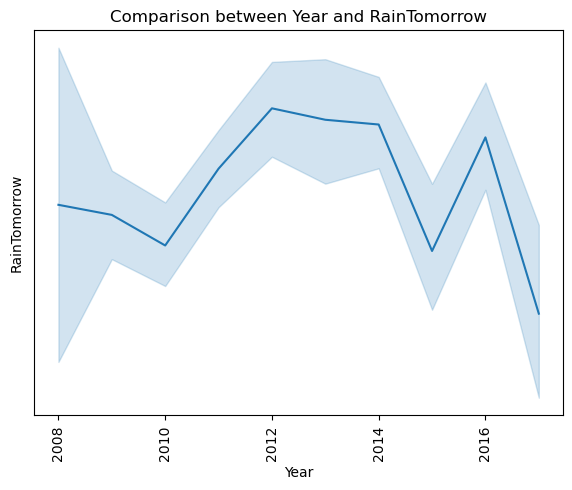

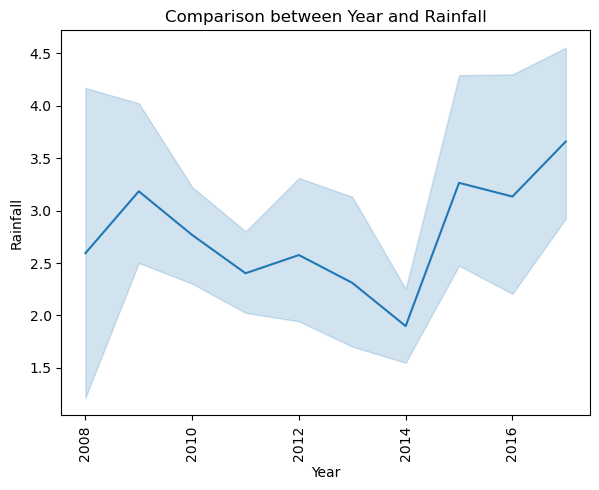

In [55]:
# Let's check the correlation of the column 'Year' with both the targets ('Rainfall' and 'RainTommorow')


plt.figure(figsize=(15,5))
plt.subplot(1,2,2)
plt.title('Comparison between Year and RainTomorrow')
sns.lineplot(x='Year', y='RainTomorrow', data=df)
plt.xticks(rotation=90)
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Comparison between Year and Rainfall')
sns.lineplot(x='Year', y='Rainfall', data=df)
plt.xticks(rotation=90)
plt.show()

<b>As we can see, 'Year' has no linear relationship with both the target variables 'RainTomorrow' and 'Rainfall'.</b>

# Multivariate Analysis

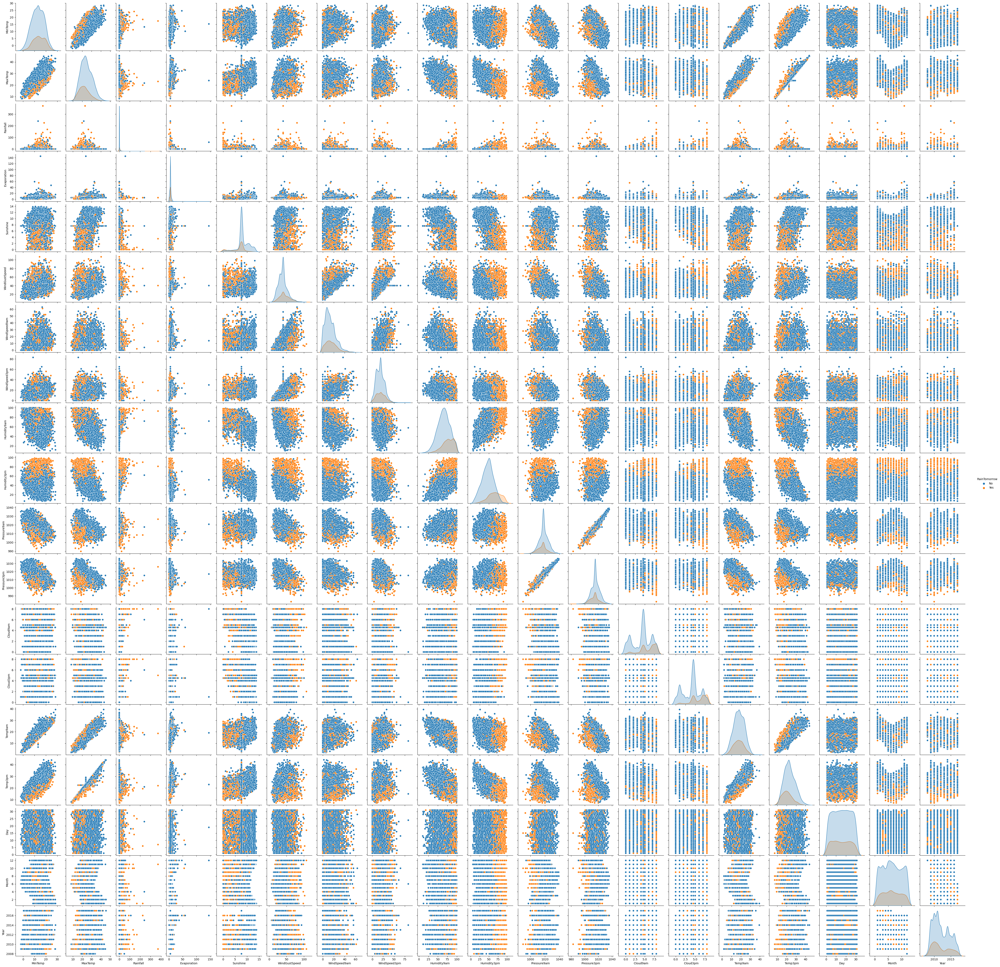

In [56]:
sns.pairplot(df, hue='RainTomorrow')
plt.show()

<b>The above pairplot gives the pairwise relationship between the columns which is plotted on the basis of the target variable 'RainTomorrow'</b>.

# Outliers Detection

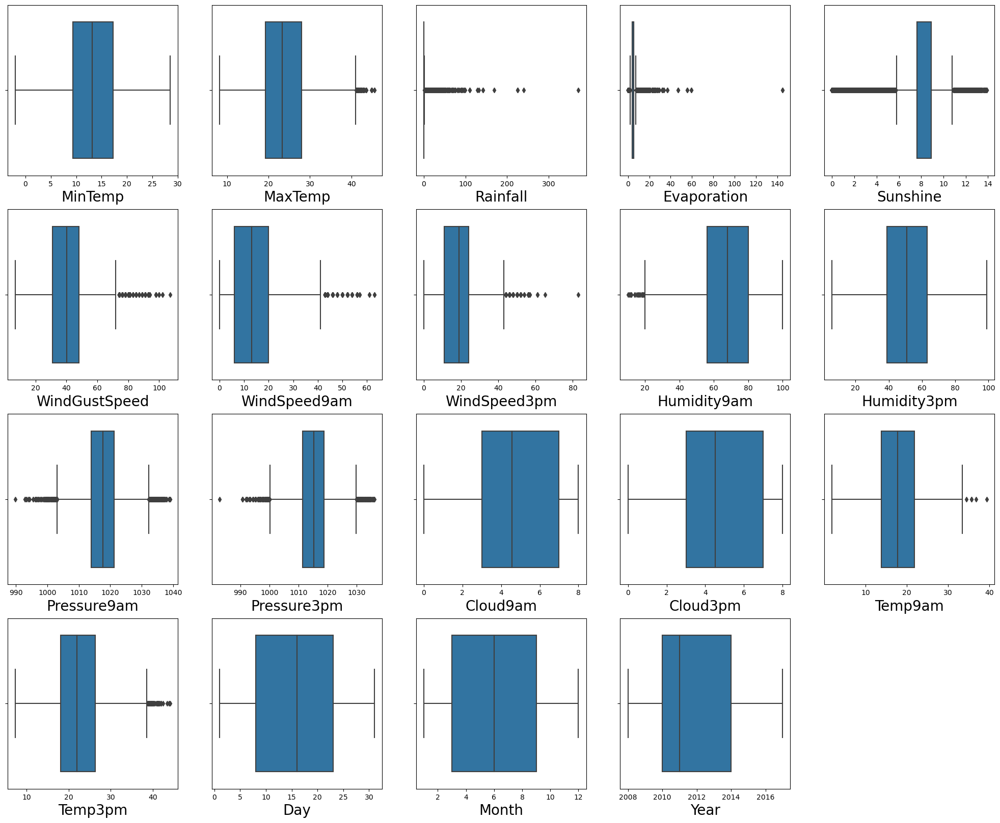

In [58]:
plt.figure(figsize=(25,20))
plotnumber = 1

for column in numerical_columns:
    if plotnumber<=20:
        ax = plt.subplot(4,5,plotnumber)
        sns.boxplot(df[column])
        plt.xlabel(column,fontsize = 20)
    plotnumber+=1
plt.show()

<b>As we can see, outliers are present in the columns 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Pressure9am', 'Pressure3pm', 'Temp9am' and 'Temp3pm'.</b>

In [59]:
features = df[['MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Pressure9am', 'Pressure3pm', 'Temp9am', 'Temp3pm']]

from scipy.stats import zscore

z = np.abs(zscore(features))
z

,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Pressure9am,Pressure3pm,Temp9am,Temp3pm
0,1.570089e-01,0.206021,2.305893e-16,1.257472e-15,0.277710,0.607461,0.563297,0.189439,1.584003,1.308665,0.153712,0.108138
1,2.028121e-01,0.264165,2.305893e-16,1.257472e-15,0.277710,0.972321,0.357200,1.420268,1.121880,1.196072,0.100217,0.312348
2,3.009450e-01,0.264165,2.305893e-16,1.257472e-15,0.422897,0.508725,0.769394,1.777981,1.599939,1.051309,0.577390,0.127334
3,6.771214e-01,0.264165,2.305893e-16,1.257472e-15,1.174166,0.281166,0.982428,1.360650,0.006411,0.391836,0.060269,0.682376
4,1.380408e+00,0.167258,2.305893e-16,1.257472e-15,0.059928,0.676112,0.151104,0.845246,1.090010,1.485596,0.006773,1.220599
...,...,...,...,...,...,...,...,...,...,...,...,...
8420,7.523137e-02,0.264165,2.305893e-16,1.257472e-15,0.666009,0.083694,0.776331,1.002937,1.109058,0.814518,1.366273,0.007221
8421,2.355231e-01,0.264165,2.305893e-16,1.257472e-15,1.319354,0.083694,0.982428,0.704843,0.933770,0.621501,1.223619,0.345987
8422,4.972110e-01,0.264165,2.305893e-16,1.257472e-15,0.230447,0.478639,0.982428,0.883699,0.535388,0.251553,0.938310,0.615099
8423,5.135665e-01,0.264165,2.305893e-16,1.257472e-15,0.883791,0.083694,1.188525,1.002937,0.280424,0.203299,0.474684,0.598279


In [60]:
# Now, let's create a new dataframe

df_new = df[(z<3).all(axis=1)]
df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.4,22.900000,0.6,5.389395,7.632205,W,44.000000,W,WNW,...,1007.1,8.000000,4.503183,16.9,21.8,No,No,1,12,2008
1,Albury,7.4,25.100000,0.0,5.389395,7.632205,WNW,44.000000,NNW,WSW,...,1007.8,4.566622,4.503183,17.2,24.3,No,No,2,12,2008
2,Albury,12.9,25.700000,0.0,5.389395,7.632205,WSW,46.000000,W,WSW,...,1008.7,4.566622,2.000000,21.0,23.2,No,No,3,12,2008
3,Albury,9.2,28.000000,0.0,5.389395,7.632205,NE,24.000000,SE,E,...,1012.8,4.566622,4.503183,18.1,26.5,No,No,4,12,2008
4,Albury,17.5,32.300000,1.0,5.389395,7.632205,W,41.000000,ENE,NW,...,1006.0,7.000000,8.000000,17.8,29.7,No,No,5,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.400000,0.0,5.389395,7.632205,E,31.000000,SE,ENE,...,1020.3,4.566622,4.503183,10.1,22.4,No,No,21,6,2017
8421,Uluru,3.6,25.300000,0.0,5.389395,7.632205,NNW,22.000000,SE,N,...,1019.1,4.566622,4.503183,10.9,24.5,No,No,22,6,2017
8422,Uluru,5.4,26.900000,0.0,5.389395,7.632205,N,37.000000,SE,WNW,...,1016.8,4.566622,4.503183,12.5,26.1,No,No,23,6,2017
8423,Uluru,7.8,27.000000,0.0,5.389395,7.632205,SE,28.000000,SSE,N,...,1016.5,3.000000,2.000000,15.1,26.0,No,No,24,6,2017


In [61]:
print(df.shape) 
print(df_new.shape) 

(8425, 25)
(7987, 25)


# Percentage data loss

In [62]:
loss_percent = (8425-7987)/8425*100
print(loss_percent, '%')

5.198813056379822 %


<b>As the data loss is just 5.19%, we can proceed further.</b>

In [63]:
df_new.shape

(7987, 25)

# Checking for Skewness

In [64]:
df_new.skew().sort_values()

Sunshine        -0.723970
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Day              0.002731
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
WindGustSpeed    0.506897
WindSpeed9am     0.711395
Evaporation      0.846181
Rainfall         3.519090
dtype: float64

<b>As we can see, the columns 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'Evaporation' and 'Rainfall' do not lie in the range of +/-0.5. thus, skewness is present in these columns.</b>

# Removing Skewness using yeo-johnson method

In [65]:
skewed_features = ['Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'Evaporation', 'Rainfall']

In [66]:
from sklearn.preprocessing import PowerTransformer

scaler = PowerTransformer(method='yeo-johnson')

In [67]:
df_new[skewed_features] = scaler.fit_transform(df_new[skewed_features].values)
df_new[skewed_features].head()

,Sunshine,WindGustSpeed,WindSpeed9am,Evaporation,Rainfall
0,-0.097439,0.433926,0.784361,0.186311,0.773058
1,-0.097439,0.433926,-0.983463,0.186311,-0.654231
2,-0.097439,0.579399,0.700314,0.186311,-0.654231
3,-0.097439,-1.257142,-0.063397,0.186311,-0.654231
4,-0.097439,0.209370,-0.541317,0.186311,1.135607


In [68]:
# Now, let's check the skewness again after applying yeo-johnson method

df_new.skew().sort_values()

Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
WindSpeed9am    -0.111481
MinTemp         -0.084549
Sunshine        -0.066262
Temp9am         -0.038035
Day              0.002731
WindGustSpeed    0.003128
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Evaporation      0.074744
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
Rainfall         1.040980
dtype: float64

In [69]:
#Removing skewness in the colun 'Rainfall' using log transformation

df_new['Rainfall'] = np.log1p(df_new['Rainfall'])

In [70]:
df_new.skew().sort_values()

Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
WindSpeed9am    -0.111481
MinTemp         -0.084549
Sunshine        -0.066262
Temp9am         -0.038035
Day              0.002731
WindGustSpeed    0.003128
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Evaporation      0.074744
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
Rainfall         0.845049
dtype: float64

<b>As we can see, skewness is removed to the maximum extent.</b>

# Now, let's visualize the data using distplot.

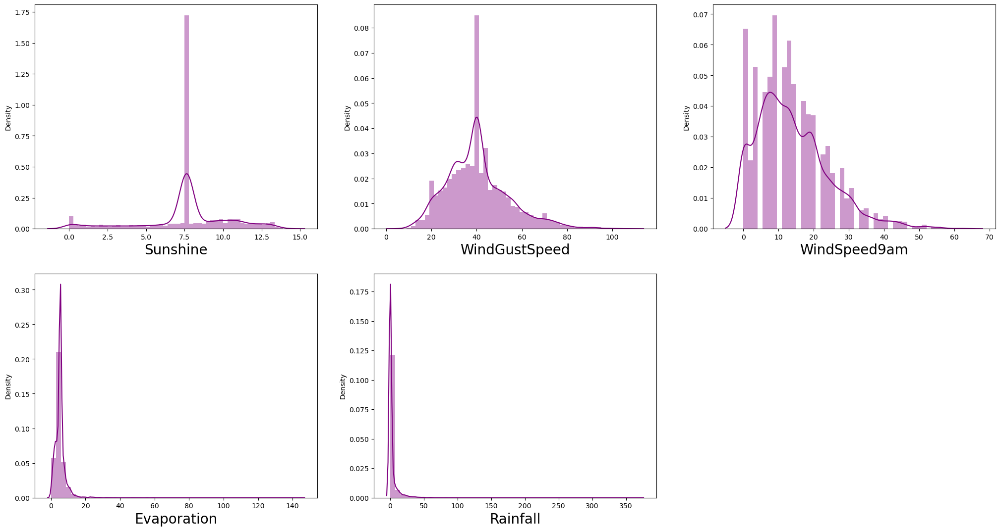

In [71]:
skewed_features = ['Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'Evaporation', 'Rainfall']
plt.figure(figsize=(25,20), facecolor='white')
plotnumber = 1

for column in df_new[skewed_features]:
    if plotnumber<=6:
        ax = plt.subplot(3,3,plotnumber)
        sns.distplot(df[column], color='purple')
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.show()

<b>As we can see, the skewness has been removed and the data appears to be normal.</b>

# Encoding the categorical columns using Label Encoding

In [72]:
from sklearn.preprocessing import LabelEncoder

LE = LabelEncoder()

df_new[categorical_columns] = df_new[categorical_columns].apply(LE.fit_transform)
df_new[categorical_columns]

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow
0,1,13,13,14,0,0
1,1,14,6,15,0,0
2,1,15,13,15,0,0
3,1,4,9,0,0,0
4,1,13,1,7,0,0
...,...,...,...,...,...,...
8420,9,0,9,1,0,0
8421,9,6,9,3,0,0
8422,9,3,9,14,0,0
8423,9,9,10,3,0,0


# Correlation between features and labels

In [73]:
corr = df_new.corr()
corr

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
Location,1.000000,0.116694,0.063798,0.009639,0.131179,0.039174,-0.037707,0.256665,-0.041030,-0.031195,...,-0.012288,0.041859,0.027050,0.118100,0.060707,0.002934,0.009222,-0.004978,-0.086011,0.481143
MinTemp,0.116694,1.000000,0.718598,0.052980,0.372252,0.087866,-0.154935,0.248262,-0.045231,-0.154184,...,-0.427936,0.089354,0.036649,0.888690,0.687570,0.061728,0.091021,0.010924,-0.247066,0.040001
MaxTemp,0.063798,0.718598,1.000000,-0.256299,0.472324,0.403083,-0.237955,0.150891,-0.217160,-0.190417,...,-0.414358,-0.252579,-0.248268,0.864864,0.974957,-0.219747,-0.149708,0.017068,-0.164351,0.120204
Rainfall,0.009639,0.052980,-0.256299,1.000000,-0.198552,-0.266296,0.134170,0.063070,0.155621,0.123405,...,-0.021809,0.302834,0.271987,-0.120315,-0.266349,0.878298,0.307088,-0.018813,-0.005659,0.009945
Evaporation,0.131179,0.372252,0.472324,-0.198552,1.000000,0.389848,-0.121155,0.184559,-0.109834,-0.038439,...,-0.277819,-0.111289,-0.144923,0.440687,0.458644,-0.167131,-0.090305,0.010870,-0.053227,0.136797
Sunshine,0.039174,0.087866,0.403083,-0.266296,0.389848,1.000000,-0.112272,0.031188,-0.082335,-0.073518,...,-0.074037,-0.543857,-0.555038,0.285620,0.418462,-0.223070,-0.315207,0.004631,0.001092,0.024638
WindGustDir,-0.037707,-0.154935,-0.237955,0.134170,-0.121155,-0.112272,1.000000,0.001046,0.405681,0.507292,...,-0.008263,0.123415,0.093527,-0.185080,-0.249791,0.121709,0.044378,0.017003,0.038044,-0.096042
WindGustSpeed,0.256665,0.248262,0.150891,0.063070,0.184559,0.031188,0.001046,1.000000,-0.065546,0.082824,...,-0.331655,0.007757,0.059312,0.219017,0.116454,0.076276,0.172749,-0.005556,0.047451,-0.024871
WindDir9am,-0.041030,-0.045231,-0.217160,0.155621,-0.109834,-0.082335,0.405681,-0.065546,1.000000,0.243622,...,0.081400,0.092396,0.062637,-0.101576,-0.224390,0.149239,0.027091,-0.010014,0.018344,-0.034468
WindDir3pm,-0.031195,-0.154184,-0.190417,0.123405,-0.038439,-0.073518,0.507292,0.082824,0.243622,1.000000,...,-0.037280,0.073742,0.054321,-0.172000,-0.202000,0.100983,0.003674,-0.000714,0.028629,-0.010781


# Correlation between features and labels using Heatmap

<AxesSubplot:>

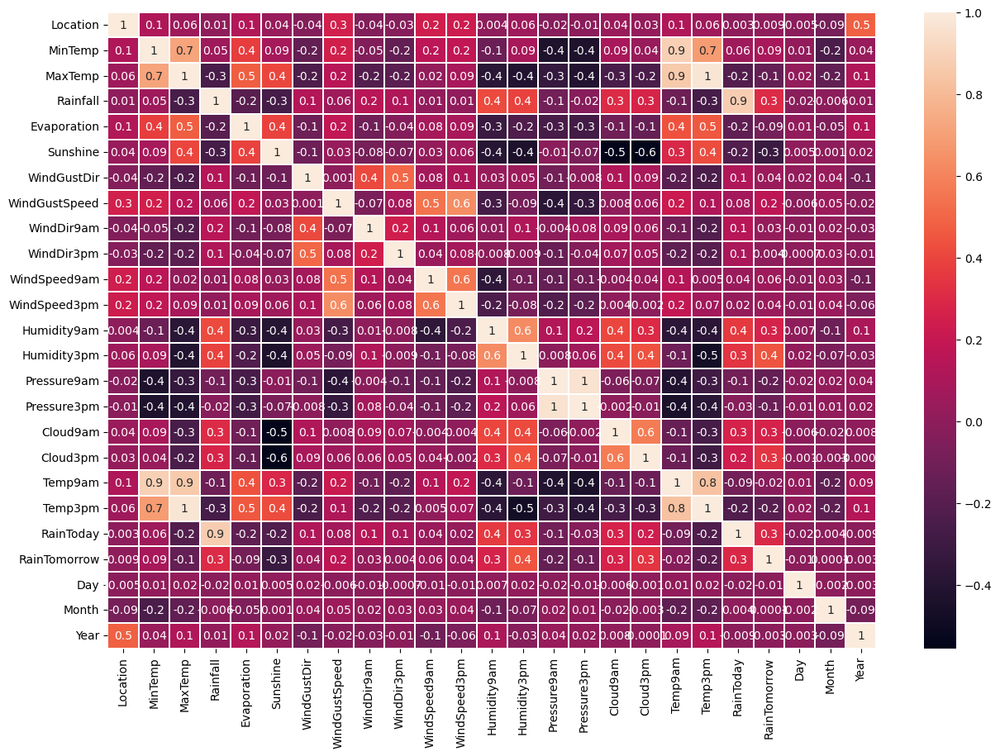

In [74]:
plt.figure(figsize=(15,10))

sns.heatmap(df_new.corr(), linewidths=0.1, fmt='.1g', annot = True)

# ---------------------------------------------------------------------------------------------------------------

# Prediction for RainTomorrow

# Let's design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

In [75]:
corr['RainTomorrow'].sort_values(ascending=False)

RainTomorrow     1.000000
Humidity3pm      0.445891
Cloud3pm         0.337922
Rainfall         0.307088
RainToday        0.294528
Humidity9am      0.269722
Cloud9am         0.269598
WindGustSpeed    0.172749
MinTemp          0.091021
WindSpeed9am     0.057062
WindGustDir      0.044378
WindSpeed3pm     0.042472
WindDir9am       0.027091
Location         0.009222
WindDir3pm       0.003674
Month            0.000135
Year            -0.003180
Day             -0.012493
Temp9am         -0.021459
Evaporation     -0.090305
Pressure3pm     -0.124953
MaxTemp         -0.149708
Pressure9am     -0.152692
Temp3pm         -0.191706
Sunshine        -0.315207
Name: RainTomorrow, dtype: float64

<b>As we can see, the column 'Humidity3pm' has the highest correlation with the target variable 'RainTomorrow'.</b>

In [76]:
corr['Rainfall'].sort_values(ascending=False)

Rainfall         1.000000
RainToday        0.878298
Humidity9am      0.412016
Humidity3pm      0.389712
RainTomorrow     0.307088
Cloud9am         0.302834
Cloud3pm         0.271987
WindDir9am       0.155621
WindGustDir      0.134170
WindDir3pm       0.123405
WindGustSpeed    0.063070
MinTemp          0.052980
WindSpeed3pm     0.011732
WindSpeed9am     0.011118
Year             0.009945
Location         0.009639
Month           -0.005659
Day             -0.018813
Pressure3pm     -0.021809
Pressure9am     -0.098198
Temp9am         -0.120315
Evaporation     -0.198552
MaxTemp         -0.256299
Sunshine        -0.266296
Temp3pm         -0.266349
Name: Rainfall, dtype: float64

<b>As we can see, the column 'RainToday' has the highest correlation with the target variable 'Rainfall'.</b>

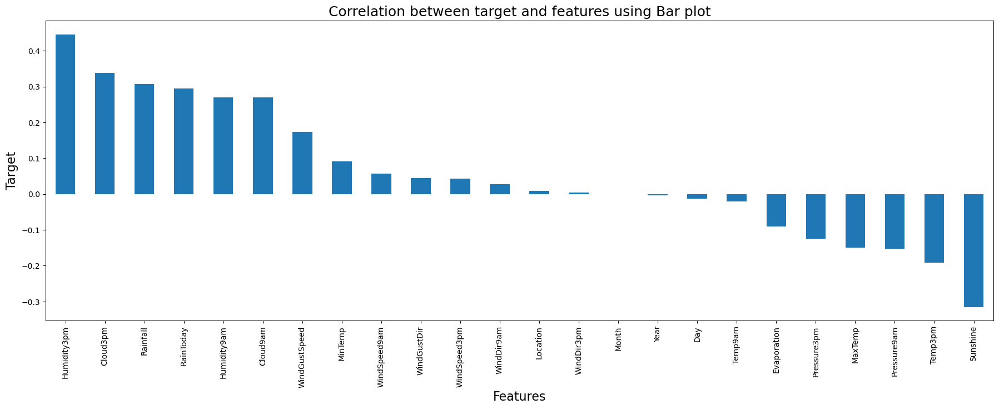

In [77]:
plt.figure(figsize=(22,7))
df_new.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar')
plt.xlabel('Features',fontsize=16)
plt.ylabel('Target',fontsize=16)
plt.title('Correlation between target and features using Bar plot',fontsize=18)
plt.show()

# Separating dependent and independent variables

In [78]:
x = df_new.drop('RainTomorrow', axis=1)

y = df_new['RainTomorrow']

In [79]:
x.shape

(7987, 24)

In [80]:
y.shape

(7987,)

# Data Standardization using Standard Scaler

In [81]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

x = pd.DataFrame(scaler.fit_transform(x), columns = x.columns)
x

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Day,Month,Year
0,-1.508427,0.056444,-0.145732,1.142269,0.186311,-0.097439,1.229267,0.433926,1.250245,1.400214,...,-1.687142,-1.398115,1.425345,0.013138,-0.138099,-0.098593,-0.542476,-1.671657,1.634113,-1.661315
1,-1.508427,-1.058476,0.220676,-0.690128,0.186311,-0.097439,1.441960,0.433926,-0.277857,1.626597,...,-1.202435,-1.279988,0.011773,0.013138,-0.084254,0.329747,-0.542476,-1.557976,1.634113,-1.661315
2,-1.508427,-0.036466,0.320605,-0.690128,0.186311,-0.097439,1.654654,0.579399,1.250245,1.626597,...,-1.703856,-1.128109,0.011773,-1.076661,0.597788,0.141277,-0.542476,-1.444296,1.634113,-1.661315
3,-1.508427,-0.724000,0.703668,-0.690128,0.186311,-0.097439,-0.684977,-1.257142,0.377044,-1.769138,...,-0.032451,-0.436219,0.011773,0.013138,0.077282,0.706687,-0.542476,-1.330616,1.634113,-1.661315
4,-1.508427,0.818306,1.419829,1.350816,0.186311,-0.097439,1.229267,0.209370,-1.369358,-0.184462,...,-1.169007,-1.583744,1.013630,1.535531,0.023437,1.254963,-0.542476,-1.216936,1.634113,-1.661315
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7982,1.029423,-1.913248,-0.062457,-0.690128,0.186311,-0.097439,-1.535751,-0.605532,0.377044,-1.542755,...,1.137532,0.829435,0.011773,0.013138,-1.358595,0.004208,-0.542476,0.601949,-0.123726,2.004134
7983,1.029423,-1.764592,0.253986,-0.690128,0.186311,-0.097439,-0.259589,-1.460065,0.377044,-1.089991,...,0.953678,0.626930,0.011773,0.013138,-1.215007,0.364014,-0.542476,0.715629,-0.123726,2.004134
7984,1.029423,-1.430116,0.520464,-0.690128,0.186311,-0.097439,-0.897670,-0.103212,0.377044,1.400214,...,0.535827,0.238796,0.011773,0.013138,-0.927832,0.638152,-0.542476,0.829310,-0.123726,2.004134
7985,1.029423,-0.984148,0.537119,-0.690128,0.186311,-0.097439,0.378492,-0.874832,0.595344,-1.089991,...,0.268402,0.188170,-0.633229,-1.076661,-0.461172,0.621019,-0.542476,0.942990,-0.123726,2.004134


<b>The data has been scaled now.</b>

# Checking VIF values to solve multicollinearity

In [82]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()

vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.588863,Location
1,8.840445,MinTemp
2,26.391566,MaxTemp
3,4.783604,Rainfall
4,1.570113,Evaporation
5,2.056091,Sunshine
6,1.618032,WindGustDir
7,2.265873,WindGustSpeed
8,1.363407,WindDir9am
9,1.491076,WindDir3pm


<b>The columns 'MaxTemp', 'Pressure9am', 'Pressure3pm', 'Temp9am' and 'Temp3pm' have vif greater than 10. Let's drop the column with highest vif score, i.e, the column 'Temp3pm'.</b>

In [83]:
x.drop('Temp3pm', axis=1, inplace=True)

In [84]:
# Now, let's check the VIF again, after removing the column 'Temp3pm'

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,1.588108,Location
1,8.800359,MinTemp
2,9.675487,MaxTemp
3,4.783544,Rainfall
4,1.569238,Evaporation
5,2.056080,Sunshine
6,1.614707,WindGustDir
7,2.256641,WindGustSpeed
8,1.362500,WindDir9am
9,1.490122,WindDir3pm


<b>Now, the columns 'Pressure9am', 'Pressure3pm' and 'Temp9am' have vif greater than 10. Let's drop the column with highest vif score, i.e, the column 'Pressure9am'.</b>

In [85]:
x.drop('Pressure9am', axis=1, inplace=True)

In [86]:
# Now, let's check the VIF again, after removing the column 'Pressure9am'

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,1.588089,Location
1,8.682133,MinTemp
2,9.282498,MaxTemp
3,4.776722,Rainfall
4,1.548635,Evaporation
5,2.047265,Sunshine
6,1.600372,WindGustDir
7,2.236718,WindGustSpeed
8,1.340286,WindDir9am
9,1.422423,WindDir3pm


<b>As we can see, the column 'Temp9am' has vif greater than 10. So, let's drop this column.</b>

In [87]:
x.drop('Temp9am', axis=1, inplace=True)

In [88]:
# Now, let's check the VIF again, after removing the column 'Temp9am'

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,1.585573,Location
1,4.538805,MinTemp
2,5.514960,MaxTemp
3,4.775587,Rainfall
4,1.542333,Evaporation
5,2.037570,Sunshine
6,1.598533,WindGustDir
7,2.198770,WindGustSpeed
8,1.340155,WindDir9am
9,1.422061,WindDir3pm


<b>As we can see, the vif value of all the columns is less than 10. Hence, we can conclude that the multicollinearity problem has been solved.</b>

# Balancing the dataset using SMOTE

In [89]:
y.value_counts()

0    6165
1    1822
Name: RainTomorrow, dtype: int64

In [90]:
from imblearn.over_sampling import SMOTE

SM = SMOTE()
x, y = SM.fit_resample(x,y)

In [91]:
y.value_counts()

0    6165
1    6165
Name: RainTomorrow, dtype: int64

<AxesSubplot:xlabel='RainTomorrow', ylabel='count'>

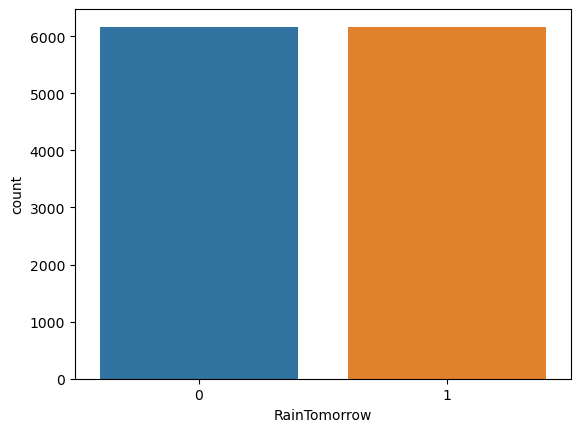

In [92]:
sns.countplot(y)

# Finding best random state

In [93]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

In [94]:
from sklearn.linear_model import LogisticRegression

maxAccu = 0
maxRS = 0
for i in range(1,200):
    xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size=.25, random_state =i)
    LR = LogisticRegression()
    LR.fit(xtrain, ytrain)
    pred = LR.predict(xtest)
    acc=accuracy_score(ytest, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ", maxAccu, " on Random_state ", maxRS)

Best accuracy is  0.7898151151475835  on Random_state  153


# Train Test Split

In [95]:
xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size=.25, random_state=maxRS)

In [96]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.metrics import roc_curve, roc_auc_score

# Logistic Regression

In [97]:
LR.fit(xtrain,ytrain)

predlr = LR.predict(xtest)
print(f"Accuracy Score: {accuracy_score(ytest,predlr)*100}%")
print(f"roc_auc_score: {roc_auc_score(ytest,predlr)*100}%")
print("---------------------------------------------------")

print(f"Confusion Matrix : \n {confusion_matrix(ytest,predlr)}\n")
print(f"CLASSIFICATION REPORT : \n {classification_report(ytest,predlr)}")

Accuracy Score: 78.98151151475835%
roc_auc_score: 78.98334999848498%
---------------------------------------------------
Confusion Matrix : 
 [[1233  306]
 [ 342 1202]]

CLASSIFICATION REPORT : 
               precision    recall  f1-score   support

           0       0.78      0.80      0.79      1539
           1       0.80      0.78      0.79      1544

    accuracy                           0.79      3083
   macro avg       0.79      0.79      0.79      3083
weighted avg       0.79      0.79      0.79      3083



# Random Forest Classifier

In [98]:
from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier()
rfc.fit(xtrain,ytrain)
pred_rfc = rfc.predict(xtest)
print(f"Accuracy Score: {accuracy_score(ytest,pred_rfc)*100}%")
print(f"roc_auc_score: {roc_auc_score(ytest,pred_rfc)*100}%")
print("---------------------------------------------------")

print(f"Confusion Matrix : \n {confusion_matrix(ytest,pred_rfc)}\n")
print(f"CLASSIFICATION REPORT : \n {classification_report(ytest,pred_rfc)}")

Accuracy Score: 93.99935128121959%
roc_auc_score: 93.9994933120558%
---------------------------------------------------
Confusion Matrix : 
 [[1448   91]
 [  94 1450]]

CLASSIFICATION REPORT : 
               precision    recall  f1-score   support

           0       0.94      0.94      0.94      1539
           1       0.94      0.94      0.94      1544

    accuracy                           0.94      3083
   macro avg       0.94      0.94      0.94      3083
weighted avg       0.94      0.94      0.94      3083



# KNeighbors Classifier

In [99]:
from sklearn.neighbors import KNeighborsClassifier

knc = KNeighborsClassifier()
knc.fit(xtrain,ytrain)
pred_knc = knc.predict(xtest)
print(f"Accuracy Score: {accuracy_score(ytest,pred_knc)*100}%")
print(f"roc_auc_score: {roc_auc_score(ytest,pred_knc)*100}%")
print("---------------------------------------------------")

print(f"Confusion Matrix : \n {confusion_matrix(ytest,pred_knc)}\n")
print(f"CLASSIFICATION REPORT : \n {classification_report(ytest,pred_knc)}")

Accuracy Score: 86.6039571845605%
roc_auc_score: 86.58850878876332%
---------------------------------------------------
Confusion Matrix : 
 [[1186  353]
 [  60 1484]]

CLASSIFICATION REPORT : 
               precision    recall  f1-score   support

           0       0.95      0.77      0.85      1539
           1       0.81      0.96      0.88      1544

    accuracy                           0.87      3083
   macro avg       0.88      0.87      0.86      3083
weighted avg       0.88      0.87      0.86      3083



# Support Vector Machine Classifier

In [100]:
from sklearn.svm import SVC

svc = SVC()
svc.fit(xtrain,ytrain)
pred_svc = svc.predict(xtest)
print(f"Accuracy Score: {accuracy_score(ytest,pred_svc)*100}%")
print(f"roc_auc_score: {roc_auc_score(ytest,pred_svc)*100}%")
print("---------------------------------------------------")

print(f"Confusion Matrix : \n {confusion_matrix(ytest,pred_svc)}\n")
print(f"CLASSIFICATION REPORT : \n {classification_report(ytest,pred_svc)}")

Accuracy Score: 86.63639312358093%
roc_auc_score: 86.63372774192246%
---------------------------------------------------
Confusion Matrix : 
 [[1308  231]
 [ 181 1363]]

CLASSIFICATION REPORT : 
               precision    recall  f1-score   support

           0       0.88      0.85      0.86      1539
           1       0.86      0.88      0.87      1544

    accuracy                           0.87      3083
   macro avg       0.87      0.87      0.87      3083
weighted avg       0.87      0.87      0.87      3083



# XGB Classifier

In [101]:
from xgboost import XGBClassifier

xgb = XGBClassifier()
xgb.fit(xtrain,ytrain)
pred_xgb = xgb.predict(xtest)

print(f"Accuracy Score: {accuracy_score(ytest,pred_xgb)*100}%")
print(f"roc_auc_score: {roc_auc_score(ytest,pred_xgb)*100}%")
print("--------------------------------------------------------")

print(f"Confusion Matrix : \n {confusion_matrix(ytest,pred_xgb)}\n")
print(f"CLASSIFICATION REPORT : \n {classification_report(ytest,pred_xgb)}")

Accuracy Score: 93.73986376905611%
roc_auc_score: 93.74221451248539%
--------------------------------------------------------
Confusion Matrix : 
 [[1465   74]
 [ 119 1425]]

CLASSIFICATION REPORT : 
               precision    recall  f1-score   support

           0       0.92      0.95      0.94      1539
           1       0.95      0.92      0.94      1544

    accuracy                           0.94      3083
   macro avg       0.94      0.94      0.94      3083
weighted avg       0.94      0.94      0.94      3083



# Extra Trees Classifier

In [106]:
from sklearn.ensemble import ExtraTreesClassifier

xtc = ExtraTreesClassifier()
xtc.fit(xtrain,ytrain)
pred_xtc = xtc.predict(xtest)

print(f"Accuracy Score: {accuracy_score(ytest,pred_xtc)*100}%")
print(f"roc_auc_score: {roc_auc_score(ytest,pred_xtc)*100}%")
print("--------------------------------------------------------")

print(f"Confusion Matrix : \n {confusion_matrix(ytest,pred_xtc)}\n")
print(f"CLASSIFICATION REPORT : \n {classification_report(ytest,pred_xtc)}")

Accuracy Score: 95.23191696399611%
roc_auc_score: 95.23090493456823%
--------------------------------------------------------
Confusion Matrix : 
 [[1456   83]
 [  64 1480]]

CLASSIFICATION REPORT : 
               precision    recall  f1-score   support

           0       0.96      0.95      0.95      1539
           1       0.95      0.96      0.95      1544

    accuracy                           0.95      3083
   macro avg       0.95      0.95      0.95      3083
weighted avg       0.95      0.95      0.95      3083



# Cross-Validation

In [107]:
from sklearn.model_selection import cross_val_score


print("Cross validation score of LogisticRegression() is:", cross_val_score(LR,x,y,cv=5).mean())
print("Cross validation score of RandomForestClassifier() is:", cross_val_score(rfc,x,y,cv=5).mean())
print("Cross validation score of KNeighborsClassifier() is:", cross_val_score(knc,x,y,cv=5).mean())
print("Cross validation score of SVC() is:", cross_val_score(svc,x,y,cv=5).mean())
print("Cross validation score of XGBClassifier() is:", cross_val_score(xgb,x,y,cv=5).mean())
print("Cross validation score of ExtraTreesClassifier() is:", cross_val_score(xtc,x,y,cv=5).mean())

Cross validation score of LogisticRegression() is: 0.7104622871046228
Cross validation score of RandomForestClassifier() is: 0.7815896188158961
Cross validation score of KNeighborsClassifier() is: 0.7271695052716951
Cross validation score of SVC() is: 0.7381995133819952
Cross validation score of XGBClassifier() is: 0.7194647201946471
Cross validation score of ExtraTreesClassifier() is: 0.7960259529602596


<b>As we can see, Extra Trees Classifier is the best model.</b>

# Hyperparameter Tuning

In [108]:
# Now, let's perform Hyperparameter Tuning for Extra Trees Classifier

from sklearn.model_selection import GridSearchCV


parameters = {'criterion' : ['gini','entropy'],
              'random_state' : [10, 50, 1000],
              'max_depth' : [0, 10, 20],
              'n_jobs' : [-2, -1, 1],
              'n_estimators' : [50,100, 200, 300]}

In [109]:
GCV = GridSearchCV(ExtraTreesClassifier(), parameters, cv=5)

In [110]:
GCV.fit(xtrain, ytrain)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [0, 10, 20],
                         'n_estimators': [50, 100, 200, 300],
                         'n_jobs': [-2, -1, 1],
                         'random_state': [10, 50, 1000]})

In [111]:
GCV.best_params_

{'criterion': 'gini',
 'max_depth': 20,
 'n_estimators': 300,
 'n_jobs': -2,
 'random_state': 50}

In [112]:
model = ExtraTreesClassifier(criterion='gini', max_depth=20, n_estimators=300, n_jobs=-2, random_state=50)
model.fit(xtrain, ytrain)
pred = model.predict(xtest)
acc = accuracy_score(ytest,pred)
print(acc*100)

95.19948102497567


<b>After Hyperparameter Tuning, we got an accuracy score of 95.19%</b>

# Plotting ROC-AUC curve for the best model

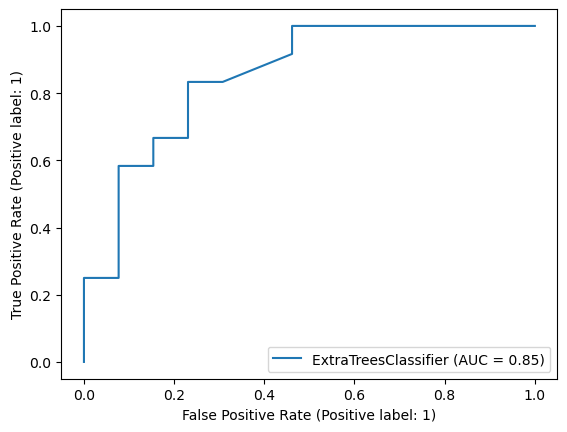

In [113]:
from sklearn import datasets 
from sklearn import metrics
from sklearn import model_selection

x,y = datasets.make_classification (random_state=maxRS)
xtrain, xtest, ytrain, ytest = model_selection.train_test_split(x, y, random_state=maxRS)
df = ExtraTreesClassifier(random_state=maxRS)
df.fit(xtrain, ytrain)
metrics.plot_roc_curve(df, xtest, ytest)
plt.show()

# Saving the model

In [114]:
import joblib

joblib.dump(model, 'RainTomorrow.pkl')

['RainTomorrow.pkl']

# ---------------------------------------------------------------------------------------------------------------

# Prediction for Rainfall

# Let's design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.

# Separating dependent and independent variables

In [115]:
x = df_new.drop('Rainfall', axis=1)

y = df_new['Rainfall']

# Data Standardization using Standard Scaler

In [116]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

x = pd.DataFrame(scaler.fit_transform(x), columns = x.columns)
x

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,-1.508427,0.056444,-0.145732,0.186311,-0.097439,1.229267,0.433926,1.250245,1.400214,0.784361,...,-1.398115,1.425345,0.013138,-0.138099,-0.098593,-0.542476,-0.543635,-1.671657,1.634113,-1.661315
1,-1.508427,-1.058476,0.220676,0.186311,-0.097439,1.441960,0.433926,-0.277857,1.626597,-0.983463,...,-1.279988,0.011773,0.013138,-0.084254,0.329747,-0.542476,-0.543635,-1.557976,1.634113,-1.661315
2,-1.508427,-0.036466,0.320605,0.186311,-0.097439,1.654654,0.579399,1.250245,1.626597,0.700314,...,-1.128109,0.011773,-1.076661,0.597788,0.141277,-0.542476,-0.543635,-1.444296,1.634113,-1.661315
3,-1.508427,-0.724000,0.703668,0.186311,-0.097439,-0.684977,-1.257142,0.377044,-1.769138,-0.063397,...,-0.436219,0.011773,0.013138,0.077282,0.706687,-0.542476,-0.543635,-1.330616,1.634113,-1.661315
4,-1.508427,0.818306,1.419829,0.186311,-0.097439,1.229267,0.209370,-1.369358,-0.184462,-0.541317,...,-1.583744,1.013630,1.535531,0.023437,1.254963,-0.542476,-0.543635,-1.216936,1.634113,-1.661315
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7982,1.029423,-1.913248,-0.062457,0.186311,-0.097439,-1.535751,-0.605532,0.377044,-1.542755,0.146229,...,0.829435,0.011773,0.013138,-1.358595,0.004208,-0.542476,-0.543635,0.601949,-0.123726,2.004134
7983,1.029423,-1.764592,0.253986,0.186311,-0.097439,-0.259589,-1.460065,0.377044,-1.089991,0.146229,...,0.626930,0.011773,0.013138,-1.215007,0.364014,-0.542476,-0.543635,0.715629,-0.123726,2.004134
7984,1.029423,-1.430116,0.520464,0.186311,-0.097439,-0.897670,-0.103212,0.377044,1.400214,-0.290718,...,0.238796,0.011773,0.013138,-0.927832,0.638152,-0.542476,-0.543635,0.829310,-0.123726,2.004134
7985,1.029423,-0.984148,0.537119,0.186311,-0.097439,0.378492,-0.874832,0.595344,-1.089991,0.146229,...,0.188170,-0.633229,-1.076661,-0.461172,0.621019,-0.542476,-0.543635,0.942990,-0.123726,2.004134


<b>The data has been scaled now.</b>

# Checking VIF values to solve multicollinearity

In [117]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()

vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.599570,Location
1,8.831144,MinTemp
2,26.369743,MaxTemp
3,1.565143,Evaporation
4,2.074070,Sunshine
5,1.620401,WindGustDir
6,2.337419,WindGustSpeed
7,1.363173,WindDir9am
8,1.489712,WindDir3pm
9,1.982144,WindSpeed9am


<b>The columns 'MaxTemp', 'Pressure9am', 'Pressure3pm', 'Temp9am' and 'Temp3pm' have vif greater than 10. Let's drop the column with highest vif score, i.e, the column 'Temp3pm'.</b>

In [118]:
x.drop('Temp3pm', axis=1, inplace=True)

In [119]:
# Now, let's check the VIF again, after removing the column 'Temp3pm'

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,1.598796,Location
1,8.791140,MinTemp
2,9.650882,MaxTemp
3,1.564256,Evaporation
4,2.074061,Sunshine
5,1.617061,WindGustDir
6,2.328002,WindGustSpeed
7,1.362263,WindDir9am
8,1.488753,WindDir3pm
9,1.982119,WindSpeed9am


<b>Now, the columns 'Pressure9am', 'Pressure3pm' and 'Temp9am' have vif greater than 10. Let's drop the column with highest vif score, i.e, the column 'Pressure9am'.</b>

In [120]:
x.drop('Pressure9am', axis=1, inplace=True)

In [121]:
# Now, let's check the VIF again, after removing the column 'Pressure9am'

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,1.598794,Location
1,8.673335,MinTemp
2,9.257843,MaxTemp
3,1.544220,Evaporation
4,2.063976,Sunshine
5,1.602122,WindGustDir
6,2.303150,WindGustSpeed
7,1.340048,WindDir9am
8,1.421194,WindDir3pm
9,1.979337,WindSpeed9am


<b>As we can see, the column 'Temp9am' has vif greater than 10. So, let's drop this column.</b>

In [122]:
x.drop('Temp9am', axis=1, inplace=True)

In [123]:
# Now, let's check the VIF again, after removing the column 'Temp9am'

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,1.596382,Location
1,4.523566,MinTemp
2,5.498156,MaxTemp
3,1.537762,Evaporation
4,2.054459,Sunshine
5,1.600247,WindGustDir
6,2.266417,WindGustSpeed
7,1.339912,WindDir9am
8,1.420852,WindDir3pm
9,1.956334,WindSpeed9am


<b>As we can see, the vif value of all the columns is less than 10. Hence, we can conclude that the multicollinearity problem has been solved.</b>

# Finding best random state

In [124]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [125]:
from sklearn.ensemble import RandomForestRegressor

maxAccu=0
maxRS=0

for i in range(1,200):
    xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size=.30, random_state=i)
    mod = RandomForestRegressor()
    mod.fit(xtrain, ytrain)
    pred = mod.predict(xtest)
    acc = r2_score(ytest, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Maximum r2 score is ",maxAccu," on Random_state ",maxRS)

Maximum r2 score is  0.8649112225746708  on Random_state  125


# Random Forest Regressor

In [126]:
from sklearn.ensemble import RandomForestRegressor

RFR = RandomForestRegressor()
RFR.fit(xtrain, ytrain)
pred_RFR = RFR.predict(xtest)

print('R2_Score:', r2_score(ytest,pred_RFR))
print('MAE:', metrics.mean_absolute_error(ytest, pred_RFR))
print('MSE:', metrics.mean_squared_error(ytest, pred_RFR))
print("RMSE:", np.sqrt(metrics.mean_squared_error(ytest, pred_RFR)))
print("CV score:", cross_val_score(RFR, x, y, cv=5).mean())

R2_Score: 0.8531660647414785
MAE: 0.19328375080325372
MSE: 0.11775401966786975
RMSE: 0.3431530557460763
CV score: 0.8221975346601983


# Gradient Boosting Regressor

In [127]:
from sklearn.ensemble import GradientBoostingRegressor

gbr = GradientBoostingRegressor()

gbr.fit(xtrain, ytrain)
predgbr = gbr.predict(xtest)

print('R2_Score:',r2_score(ytest,predgbr))
print('MAE:',metrics.mean_absolute_error(ytest, predgbr))
print('MSE:',metrics.mean_squared_error(ytest, predgbr))
print("RMSE:",np.sqrt(metrics.mean_squared_error(ytest, predgbr)))
print("CV score",cross_val_score(gbr,x,y,cv=5).mean())

R2_Score: 0.8106837474641544
MAE: 0.23159809164159717
MSE: 0.15182287177214093
RMSE: 0.3896445454156146
CV score 0.7966873117876068


# Bagging Regressor

In [128]:
from sklearn.ensemble import BaggingRegressor

br = BaggingRegressor()

br.fit(xtrain, ytrain)
predbr = br.predict(xtest)

print('R2_Score:',r2_score(ytest,predbr))
print('MAE:',metrics.mean_absolute_error(ytest, predbr))
print('MSE:',metrics.mean_squared_error(ytest, predbr))
print("RMSE:",np.sqrt(metrics.mean_squared_error(ytest, predbr)))
print("CV score",cross_val_score(br,x,y,cv=5).mean())

R2_Score: 0.8352168621772537
MAE: 0.19834897486261427
MSE: 0.13214844932099482
RMSE: 0.36352228173936574
CV score 0.804975760880404


# XGB Regressor

In [129]:
from xgboost import XGBRegressor

xgb = XGBRegressor()

xgb.fit(xtrain, ytrain)
predxgb = xgb.predict(xtest)

print('R2_Score:',r2_score(ytest,predxgb))
print('MAE:',metrics.mean_absolute_error(ytest, predxgb))
print('MSE:',metrics.mean_squared_error(ytest, predxgb))
print("RMSE:",np.sqrt(metrics.mean_squared_error(ytest, predxgb)))
print("CV score",cross_val_score(xgb,x,y,cv=5).mean())

R2_Score: 0.8368746133594867
MAE: 0.2072977446345644
MSE: 0.13081900960412413
RMSE: 0.36168910628345463
CV score 0.8021555747127046


# Extra Trees Regressor

In [130]:
from sklearn.ensemble import ExtraTreesRegressor

xtr = ExtraTreesRegressor()

xtr.fit(xtrain, ytrain)
predxtr = xtr.predict(xtest)

print('R2_Score:',r2_score(ytest,predxtr))
print('MAE:',metrics.mean_absolute_error(ytest, predxtr))
print('MSE:',metrics.mean_squared_error(ytest, predxtr))
print("RMSE:",np.sqrt(metrics.mean_squared_error(ytest, predxtr)))
print("CV score",cross_val_score(xtr,x,y,cv=5).mean())

R2_Score: 0.8617115224083172
MAE: 0.17264974609332295
MSE: 0.11090095815725776
RMSE: 0.33301795470703643
CV score 0.8337711367058411


<b>As we can see, Random Forest Regressor is the best model.</b>

# Hyperparameter Tuning

In [131]:
# Now, let's perform Hyperparameter Tuning for Random Forest Regressor

from sklearn.model_selection import GridSearchCV


parameters = {'n_estimators' : [50,100,200],
              'bootstrap':['True','False'],
              'max_depth' : [4, 6, 8],
              'max_features': ['auto', 'sqrt'], }

In [132]:
GCV = GridSearchCV(RandomForestRegressor(), parameters, cv=5)

In [133]:
GCV.fit(xtrain, ytrain)

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': ['True', 'False'], 'max_depth': [4, 6, 8],
                         'max_features': ['auto', 'sqrt'],
                         'n_estimators': [50, 100, 200]})

In [134]:
GCV.best_params_

{'bootstrap': 'True',
 'max_depth': 8,
 'max_features': 'auto',
 'n_estimators': 200}

In [135]:
# Creating the Final Model

mod = RandomForestRegressor(bootstrap='True', max_depth=8, max_features='auto', n_estimators=200)
mod.fit(xtrain, ytrain)
pred = mod.predict(xtest)
print('R2_score:',r2_score(ytest, pred)*100)
print('MAE:',metrics.mean_absolute_error(ytest, pred))
print('MSE:',metrics.mean_squared_error(ytest, pred))
print("RMSE:",np.sqrt(metrics.mean_squared_error(ytest, pred)))

R2_score: 82.01577412253735
MAE: 0.21904046788493206
MSE: 0.14422516729239862
RMSE: 0.3797698872901834


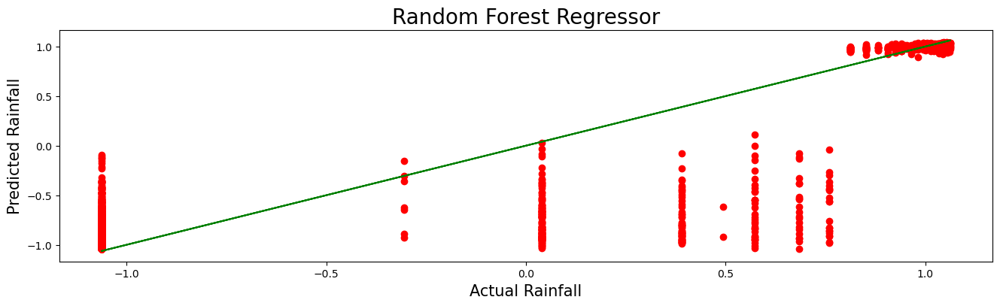

In [136]:
plt.figure(figsize=(16,4))
plt.scatter(x=ytest, y=pred, color='r')
plt.plot(ytest,ytest, color='g')
plt.xlabel('Actual Rainfall',fontsize=15)
plt.ylabel('Predicted Rainfall',fontsize=15)
plt.title('Random Forest Regressor',fontsize=20)
plt.show()

<b>After Hyperparameter Tuning, we got an accuracy score of 82.01%</b>

# Saving the Model

In [137]:
import joblib

joblib.dump(mod, 'Rainfall.pkl')

['Rainfall.pkl']

In [138]:
model=joblib.load("Rainfall.pkl")

#Prediction
prediction = model.predict(xtest)
prediction

array([-0.94883217, -0.97883282,  1.03137572, ..., -0.94417418,
       -0.92804672, -0.92791504])

In [139]:
pd.DataFrame([model.predict(xtest)[:],ytest[:]],index=["Predicted","Original"]).T

,Predicted,Original
0,-0.948832,-1.061985
1,-0.978833,-1.061985
2,1.031376,1.056451
3,-0.900146,-1.061985
4,-0.983285,-1.061985
...,...,...
2392,-0.907128,-1.061985
2393,-0.684648,0.039771
2394,-0.944174,-1.061985
2395,-0.928047,0.572706


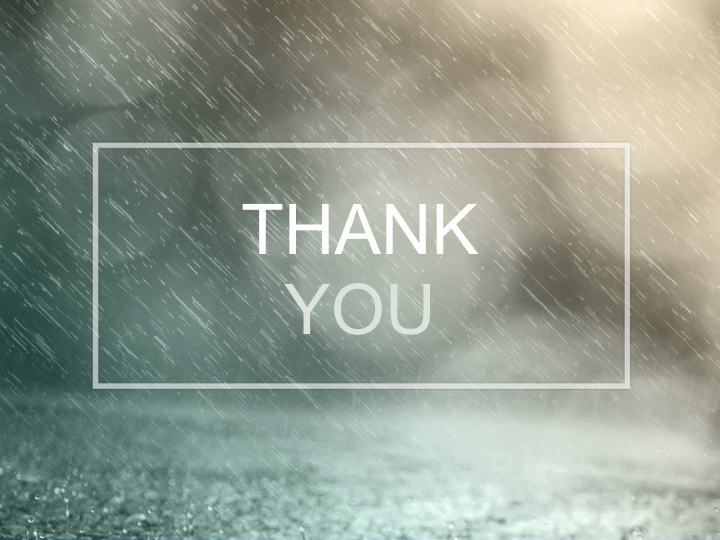